# Exploratory Analysis for the Transfer Target Model

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from mpl_toolkits import mplot3d
from scipy.stats import anderson,normaltest,zscore,iqr,chisquare,pearsonr,spearmanr,pointbiserialr,levene,chi2_contingency
from statsmodels.api import qqplot
from sklearn.model_selection import train_test_split
from sklearn.decomposition import PCA
from sklearn.preprocessing import RobustScaler
from statsmodels.stats.outliers_influence import variance_inflation_factor
import statsmodels.api as sm
from feature_engine.encoding import RareLabelEncoder,OneHotEncoder
from category_encoders import TargetEncoder
import pingouin as pg
from itertools import combinations
from scipy.stats import mannwhitneyu
import sys
import umap.umap_ as umap

sys.path.append("..\..\src")
from PY_Class_Def import RobustZ_Score,check_pca_separation

import warnings
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)

In [2]:
df=pd.read_csv(r'..\..\DataSources\Processed\Cleaned_Final_Stats_test.csv').iloc[:,1:]
df.head()

,Player,Nation,Squad,Pos,Age,League,MP,Starts,Min,90s,Gls,Ast,G+A,G-PK,PK,PKatt,CrdY,CrdR,xG,npxG,xAG,npxG+xAG,PrgC,PrgP,PrgR,G+A-PK,Gls_per_90,Ast_per_90,G+A_per_90,G-PK_per_90,G+A-PK_per_90,xG_per_90,xAG_per_90,xG+xAG_per_90,npxG_per_90,npxG+xAG_per_90,Total Tackels,TklW,Def 3rd,Mid 3rd,Att 3rd,Dribblers_Tackeld,Dribblers_Tackel_Att,Dribblers_Tackel%,Lost,Blocks,Sh,Pass,Int,Tkl+Int,Clr,Err,Total_Att,Total_Cmp%,TotDist,PrgDist,Short_Cmp,Short_Att,Short_Cmp%,Medium_Cmp,Medium_Att,Medium_Cmp%,Long_Cmp,Long_Att,Long_Cmp%,xA,A-xAG,KP,1/3,PPA,CrsPA,Touches,Touches_Def_Pen_Area,Touches_Def_3rd_Area,Touches_Mid_3rd_Area,Touches_Att_3rd_Area,Touches_Att_Pen_Area,Live_Touches_in_Game,Dribbling_Att,Dribbling_Succ,Dribbling_Succ%,Tackeld_Dribbling,Tackeld_Dribbling%,Total_Carry_Distance,Total_Progressive_Carry_Distance,Total_Carries_in_1/3,Total_Carries_in_Penalty_Area,Miscontrols_Carries,Dispossed_Carries,Passes_Received,Progressive_Passes_Received,Shot_Creating_Action,Shot_Creating_Action_90,Live_Passes_lead_Shot_Att,Dead_Passes_lead_Shot_Att,Shot_Att_after_Dribbling,Shot_lead_to_Shot_Att,Foul_drawn_lead_Shot_Att,Def_Action_lead_Shot_Att,GCA,GCA90,Live_Pass_lead_Goal,Dead_Pass_lead_Goal,Goal_after_Dribbling,Shot_lead_Goal,Foul_drawn_lead_Goal,Def_Action_lead_Goal,GA,GA90,SoTA,Saves,Save%,W,D,L,CS,CS%,PKA,PKsv,PKm,Penalty_Kick_Saves,FK,CK,OG,PSxG,PSxG/SoT,PSxG+/-,/90,Cmp,Att,Cmp%,Att (GK),Thr,Launch%_Passes,AvgLen_Passes,Goal_Kick_Att,Launch%_Goal_Kicks,AvgLen_Goal_Kicks,Opp,Stp,Stp%,#OPA,#OPA/90,AvgDist,Limited_Time,Age_Num,Transfer_Window,Club_Left,League_Left,Club_Joined,League_Joined,Transfer_Fee,Performance_Year
0,Aaron Connolly,IRL,Brighton,FW,Early Twenties,Premier League,10.5,5.0,473.5,5.25,1.0,0.5,1.5,1.0,0.0,0.0,0.0,0.0,2.20,2.2,0.15,2.35,7.5,2.5,32.5,0.170,0.115,0.055,0.170,0.115,0.170,0.33,0.040,0.370,0.330,0.370,3.0,1.5,0.5,1.5,1.0,0.0,1.5,0.00,1.5,3.0,0.0,3.0,0.0,3.0,1.0,0.0,56.5,75.15,508.0,96.0,29.5,36.5,89.25,9.5,10.5,93.75,0.0,1.0,0.0,0.10,0.35,3.5,1.5,0.5,0.0,103.5,0.5,6.0,35.0,64.0,19.5,103.5,6.5,2.5,22.75,4.0,77.25,386.5,157.0,5.5,2.5,14.5,5.0,78.0,32.5,8.5,1.430,6.0,0.0,1.0,0.5,1.0,0.0,0.5,0.055,0.5,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.5,20.5,2022,Brighton & Hove Albion,Premier League,Venezia FC,Other Leagues,0.0,2021.0
1,Aaron Connolly,IRL,Brighton,FW,Early Twenties,Premier League,10.5,5.0,473.5,5.25,1.0,0.5,1.5,1.0,0.0,0.0,0.0,0.0,2.20,2.2,0.15,2.35,7.5,2.5,32.5,0.170,0.115,0.055,0.170,0.115,0.170,0.33,0.040,0.370,0.330,0.370,3.0,1.5,0.5,1.5,1.0,0.0,1.5,0.00,1.5,3.0,0.0,3.0,0.0,3.0,1.0,0.0,56.5,75.15,508.0,96.0,29.5,36.5,89.25,9.5,10.5,93.75,0.0,1.0,0.0,0.10,0.35,3.5,1.5,0.5,0.0,103.5,0.5,6.0,35.0,64.0,19.5,103.5,6.5,2.5,22.75,4.0,77.25,386.5,157.0,5.5,2.5,14.5,5.0,78.0,32.5,8.5,1.430,6.0,0.0,1.0,0.5,1.0,0.0,0.5,0.055,0.5,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.5,20.5,2022,Brighton & Hove Albion,Premier League,Hull City,Other Leagues,0.0,2021.0
2,Aaron Hickey,GBR,Bologna,DF,Teenager,Serie A,23.5,22.0,1789.0,19.85,2.5,0.5,3.0,2.5,0.0,0.0,5.0,0.5,0.50,0.5,0.95,1.35,39.0,44.0,92.0,0.095,0.080,0.015,0.095,0.080,0.095,0.02,0.035,0.045,0.020,0.045,29.0,18.5,17.0,8.5,3.5,13.5,23.5,53.95,10.0,21.0,7.0,14.0,22.0,51.0,29.5,0.5,843.0,82.50,10043.5,2992.0,385.0,422.5,91.45,248.5,312.5,81.65,27.5,56.0,52.7,0.80,-0.45,10.5,37.5,11.0,4.5,1048.5,53.0,316.0,453.0,286.5,16.5,1048.5,32.5,18.5,52.50,14.0,47.55,3156.5,1500.0,30.0,6.0,32.0,17.5,614.5,92.0,25.5,1.115,21.5,0.5,1.0,0.5,2.0,0.0,2.5,0.125,2.5,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.5,18.5,2022,FC Bologna,Serie A,FC Brentford,Premier League,14250000.0,2021.0
3,Aaron Leya Iseka,BEL,Toulou

## Checking for Null Values

In [84]:
null_feat=[]
#with the mean we get "percentage values"
df_null=df.isnull().mean().to_frame().transpose()
for x in list(df_null.columns):
    if df_null[x][0] > 0.0:
        null_feat.append(x)
null_feat

[]

Our data does not contain any null values. Next we will split the data into train and test set. We will use only the train set for the exploratory analysis (checking for outliers, distribution, linearity, perform feature engineering etc.). We will do that, so we do not have any data leakage. We need to determine our y feature, we want to predict the league that the player will join.

In other words, we try to predict the probability of landing in the predefined leagues. I call them predefined, because I will leave the top 5 leagues as it is, in the exploratory analysis we will analyse how the non-top 5 leagues will behave and how many we have, based on that we will create appropriate features.

## Splitting the Data

In [85]:
#dropping 
X=df.drop(['League_Joined','Club_Joined','Transfer_Fee'],axis=1)
y=df['League_Joined']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=101)

## Amount of Numeric and Categorical Features

In [86]:
X_train_num=X_train.select_dtypes(exclude='object')
X_train_cat=X_train.select_dtypes(include='object')

print(f'Number of only Numeric Features: {X_train_num.shape[1]}')
print(f'Number of only Categorical Features: {X_train_cat.shape[1]}')

Number of only Numeric Features: 142
Number of only Categorical Features: 8


# Numerical Features

## Checking Distribution

In this section we will check the distribution of the numeric features, we will do that by using D'Agostino's Pearson Test, which is more robust than Smirnov Kolmogorov Test, because the test focus on skewness and kurtosis. The Smirnov Kolmogorov Test tends to categorice feature easier as a normal distribution, when you have enough data points. We will also perform the Anderson Test, which will focus more on the tail of the distribution, we should get an overall good understanding how the numeric features are distributed.

In [87]:
normal=[]
non_normal=[]

for x in list(X_train_num.columns):
    stat,p_value=normaltest(X_train_num[x])
    if p_value > 0.05:
        normal.append(x)
    else:
        non_normal.append(x)

print(f'Normal Distribution: {normal}')
print(f'Non Normal Distribution: {non_normal}')

Normal Distribution: ['Dribblers_Tackel%']
Non Normal Distribution: ['MP', 'Starts', 'Min', '90s', 'Gls', 'Ast', 'G+A', 'G-PK', 'PK', 'PKatt', 'CrdY', 'CrdR', 'xG', 'npxG', 'xAG', 'npxG+xAG', 'PrgC', 'PrgP', 'PrgR', 'G+A-PK', 'Gls_per_90', 'Ast_per_90', 'G+A_per_90', 'G-PK_per_90', 'G+A-PK_per_90', 'xG_per_90', 'xAG_per_90', 'xG+xAG_per_90', 'npxG_per_90', 'npxG+xAG_per_90', 'Total Tackels', 'TklW', 'Def 3rd', 'Mid 3rd', 'Att 3rd', 'Dribblers_Tackeld', 'Dribblers_Tackel_Att', 'Lost', 'Blocks', 'Sh', 'Pass', 'Int', 'Tkl+Int', 'Clr', 'Err', 'Total_Att', 'Total_Cmp%', 'TotDist', 'PrgDist', 'Short_Cmp', 'Short_Att', 'Short_Cmp%', 'Medium_Cmp', 'Medium_Att', 'Medium_Cmp%', 'Long_Cmp', 'Long_Att', 'Long_Cmp%', 'xA', 'A-xAG', 'KP', '1/3', 'PPA', 'CrsPA', 'Touches', 'Touches_Def_Pen_Area', 'Touches_Def_3rd_Area', 'Touches_Mid_3rd_Area', 'Touches_Att_3rd_Area', 'Touches_Att_Pen_Area', 'Live_Touches_in_Game', 'Dribbling_Att', 'Dribbling_Succ', 'Dribbling_Succ%', 'Tackeld_Dribbling', 'Tackeld_Dri

In [88]:
normal=[]
non_normal=[]

for x in list(X_train_num.columns):
    result=anderson(X_train_num[x],dist='norm')
    #determine the significane level
    index=result.significance_level.tolist().index(5.0)
    cv=result.critical_values[index]
    if result.statistic > cv:
        non_normal.append(x)
    else:
        normal.append(x)

print(f'Normal Distribution: {normal}')
print(f'Non Normal Distribution: {non_normal}')

Normal Distribution: []
Non Normal Distribution: ['MP', 'Starts', 'Min', '90s', 'Gls', 'Ast', 'G+A', 'G-PK', 'PK', 'PKatt', 'CrdY', 'CrdR', 'xG', 'npxG', 'xAG', 'npxG+xAG', 'PrgC', 'PrgP', 'PrgR', 'G+A-PK', 'Gls_per_90', 'Ast_per_90', 'G+A_per_90', 'G-PK_per_90', 'G+A-PK_per_90', 'xG_per_90', 'xAG_per_90', 'xG+xAG_per_90', 'npxG_per_90', 'npxG+xAG_per_90', 'Total Tackels', 'TklW', 'Def 3rd', 'Mid 3rd', 'Att 3rd', 'Dribblers_Tackeld', 'Dribblers_Tackel_Att', 'Dribblers_Tackel%', 'Lost', 'Blocks', 'Sh', 'Pass', 'Int', 'Tkl+Int', 'Clr', 'Err', 'Total_Att', 'Total_Cmp%', 'TotDist', 'PrgDist', 'Short_Cmp', 'Short_Att', 'Short_Cmp%', 'Medium_Cmp', 'Medium_Att', 'Medium_Cmp%', 'Long_Cmp', 'Long_Att', 'Long_Cmp%', 'xA', 'A-xAG', 'KP', '1/3', 'PPA', 'CrsPA', 'Touches', 'Touches_Def_Pen_Area', 'Touches_Def_3rd_Area', 'Touches_Mid_3rd_Area', 'Touches_Att_3rd_Area', 'Touches_Att_Pen_Area', 'Live_Touches_in_Game', 'Dribbling_Att', 'Dribbling_Succ', 'Dribbling_Succ%', 'Tackeld_Dribbling', 'Tackeld_D

## Outlier

In the previous section we have established that all numeric features do not follow a normal distribution. This will bring us to the next section, establishing/detecting outliers. Due to the fact that all features are non-normal, we will use IQR and the Robust-Z-Score to detect outliers.

The Robust-Z-Score addresses limitation of the Z-Score, which allows us to apply the Z-Score logic on non-normal data.

In [89]:
outlier_list=[]
for x in list(X_train_num.columns):
    q1=X_train_num[x].quantile(0.25)
    q3=X_train_num[x].quantile(0.75)
    iqr=q3-q1

    lower_bound=q1-(iqr*1.5)
    upper_bound=q3+(iqr*1.5)

    outliers=len(X_train_num[(X_train_num[x]<lower_bound) | (X_train_num[x]>upper_bound)])
    if outliers > 0:
        v=f'{x}-{(round(outliers/len(X_train_num),2))*100}'
        outlier_list.append(v)
print((len(outlier_list)/len(list(X_train_num.columns)))*100)
outlier_list

95.07042253521126


['Gls-8.0',
 'Ast-4.0',
 'G+A-7.000000000000001',
 'G-PK-6.0',
 'PK-14.000000000000002',
 'PKatt-17.0',
 'CrdY-3.0',
 'CrdR-19.0',
 'xG-9.0',
 'npxG-8.0',
 'xAG-5.0',
 'npxG+xAG-7.000000000000001',
 'PrgC-5.0',
 'PrgP-4.0',
 'PrgR-3.0',
 'G+A-PK-2.0',
 'Gls_per_90-4.0',
 'Ast_per_90-4.0',
 'G+A_per_90-2.0',
 'G-PK_per_90-4.0',
 'G+A-PK_per_90-2.0',
 'xG_per_90-4.0',
 'xAG_per_90-3.0',
 'xG+xAG_per_90-2.0',
 'npxG_per_90-4.0',
 'npxG+xAG_per_90-2.0',
 'Total Tackels-3.0',
 'TklW-2.0',
 'Def 3rd-3.0',
 'Mid 3rd-5.0',
 'Att 3rd-2.0',
 'Dribblers_Tackeld-3.0',
 'Dribblers_Tackel_Att-2.0',
 'Dribblers_Tackel%-1.0',
 'Lost-3.0',
 'Blocks-1.0',
 'Sh-8.0',
 'Pass-3.0',
 'Int-4.0',
 'Tkl+Int-2.0',
 'Clr-8.0',
 'Err-7.000000000000001',
 'Total_Att-2.0',
 'Total_Cmp%-4.0',
 'TotDist-3.0',
 'PrgDist-5.0',
 'Short_Cmp-2.0',
 'Short_Att-2.0',
 'Short_Cmp%-5.0',
 'Medium_Cmp-5.0',
 'Medium_Att-3.0',
 'Medium_Cmp%-1.0',
 'Long_Cmp-6.0',
 'Long_Att-5.0',
 'Long_Cmp%-4.0',
 'xA-5.0',
 'A-xAG-9.0',
 'KP-

In [90]:
outlier_z=[]
for x in list(X_train_num.columns):
    rbzs=abs(RobustZ_Score(X_train_num[x]))
    if np.any(rbzs > 3):
        outlier_z.append(f'{x}-{(round(sum(rbzs > 3)/len(X_train_num),2))*100}%')
print((len(outlier_z)/len(list(X_train_num.columns)))*100)
outlier_z

93.66197183098592


['Gls-13.0%',
 'Ast-4.0%',
 'G+A-9.0%',
 'G-PK-11.0%',
 'PK-14.000000000000002%',
 'PKatt-17.0%',
 'CrdY-2.0%',
 'CrdR-19.0%',
 'xG-12.0%',
 'npxG-10.0%',
 'xAG-6.0%',
 'npxG+xAG-8.0%',
 'PrgC-6.0%',
 'PrgP-4.0%',
 'PrgR-5.0%',
 'G+A-PK-2.0%',
 'Gls_per_90-11.0%',
 'Ast_per_90-7.000000000000001%',
 'G+A_per_90-2.0%',
 'G-PK_per_90-9.0%',
 'G+A-PK_per_90-2.0%',
 'xG_per_90-9.0%',
 'xAG_per_90-2.0%',
 'xG+xAG_per_90-3.0%',
 'npxG_per_90-7.000000000000001%',
 'npxG+xAG_per_90-3.0%',
 'Total Tackels-3.0%',
 'TklW-2.0%',
 'Def 3rd-5.0%',
 'Mid 3rd-4.0%',
 'Att 3rd-2.0%',
 'Dribblers_Tackeld-4.0%',
 'Dribblers_Tackel_Att-3.0%',
 'Lost-4.0%',
 'Blocks-1.0%',
 'Sh-11.0%',
 'Pass-2.0%',
 'Int-6.0%',
 'Tkl+Int-3.0%',
 'Clr-13.0%',
 'Err-36.0%',
 'Total_Att-2.0%',
 'Total_Cmp%-4.0%',
 'TotDist-4.0%',
 'PrgDist-8.0%',
 'Short_Cmp-2.0%',
 'Short_Att-2.0%',
 'Short_Cmp%-5.0%',
 'Medium_Cmp-6.0%',
 'Medium_Att-5.0%',
 'Medium_Cmp%-1.0%',
 'Long_Cmp-9.0%',
 'Long_Att-7.000000000000001%',
 'Long_Cmp%-1

C:\Users\gandj\AppData\Local\Temp\ipykernel_60040\337662395.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig,axes=plt.subplots(3,1,figsize=(12,8))


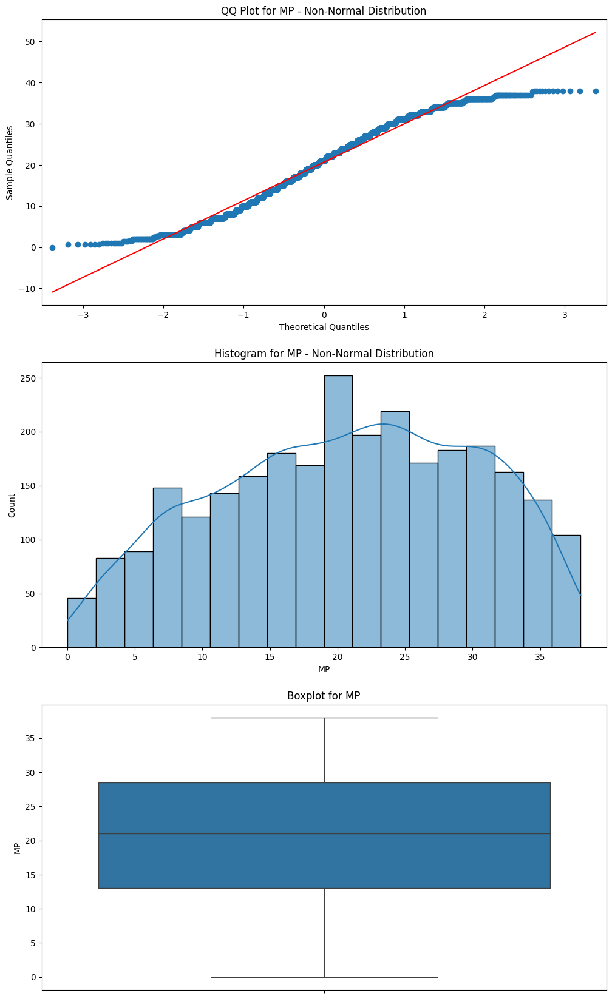

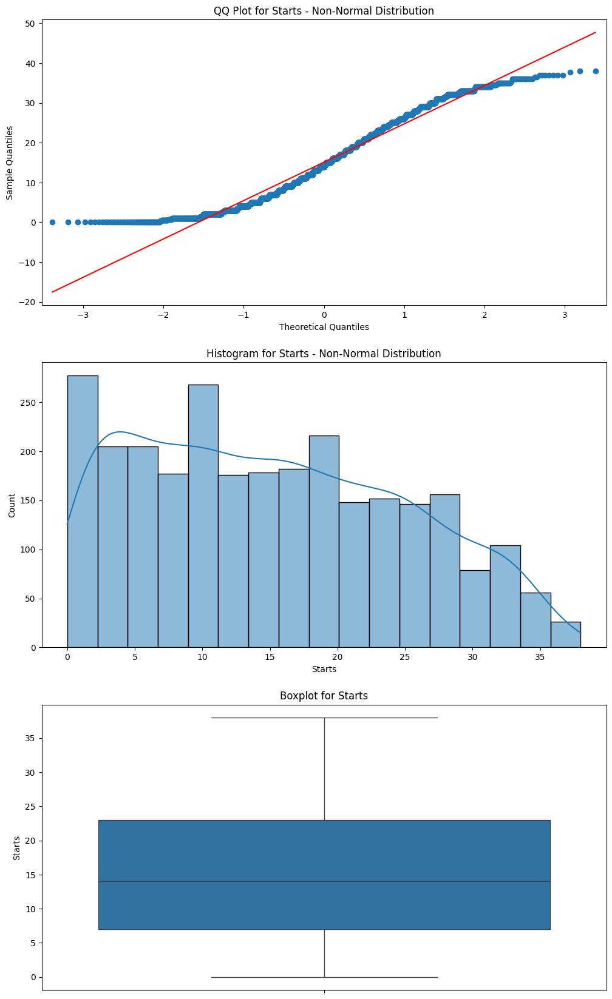

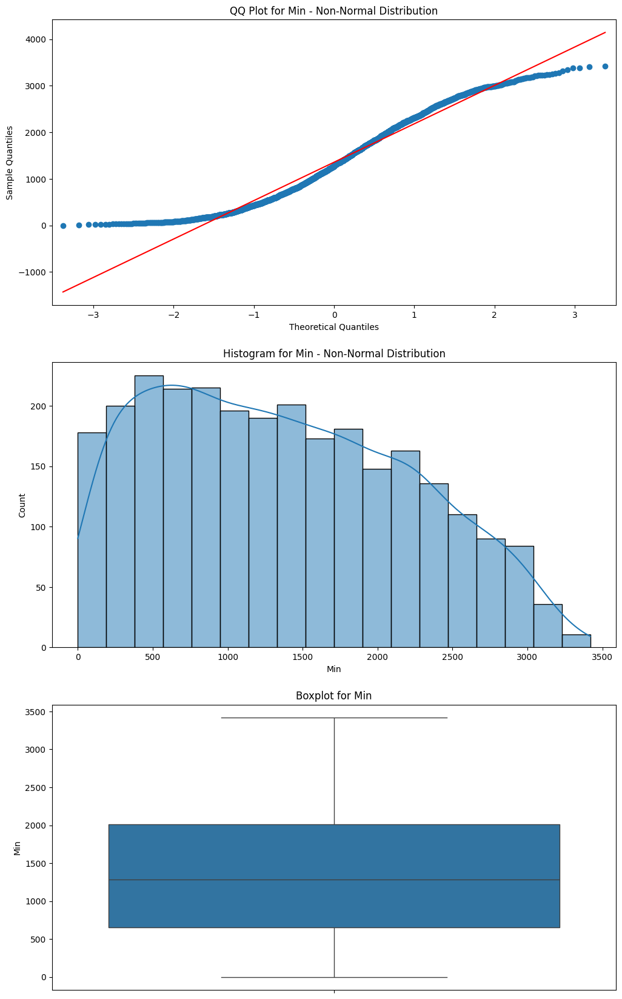

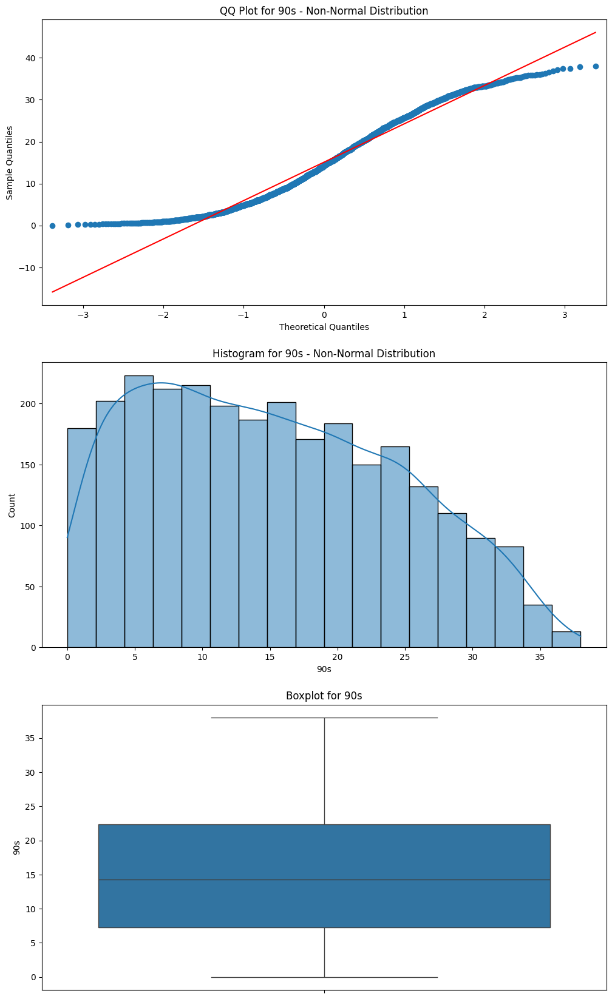

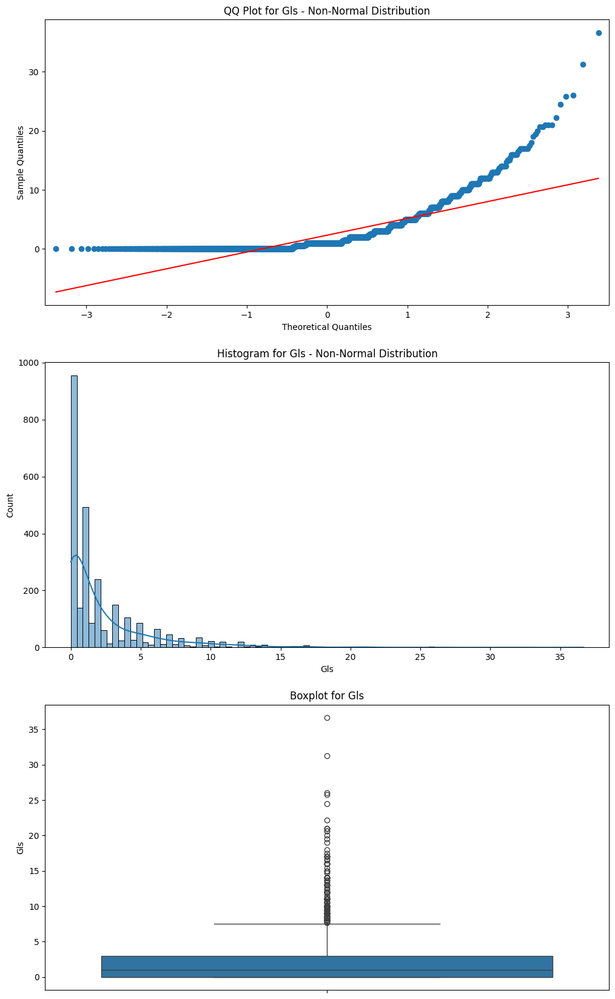

...

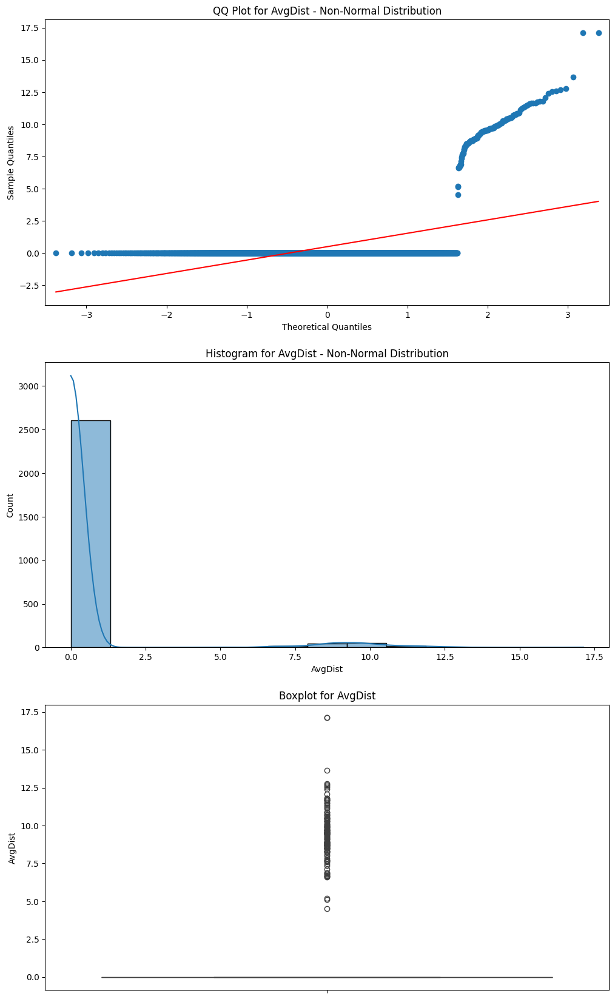

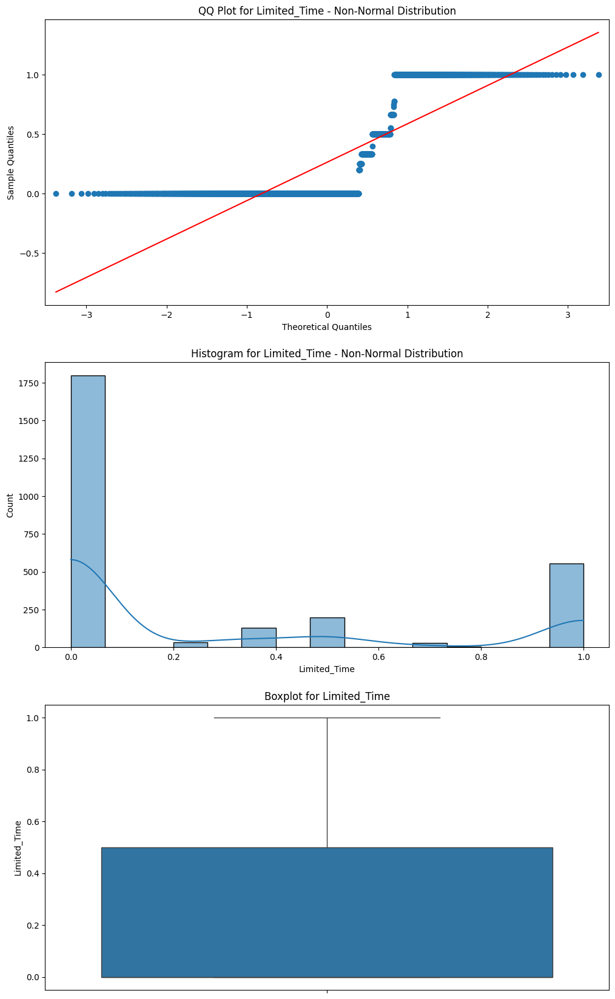

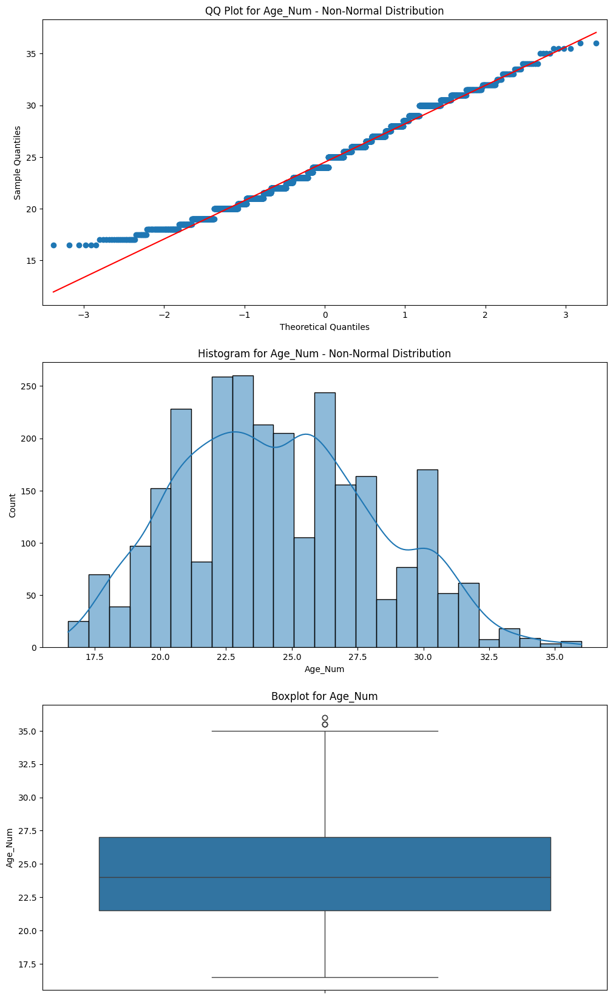

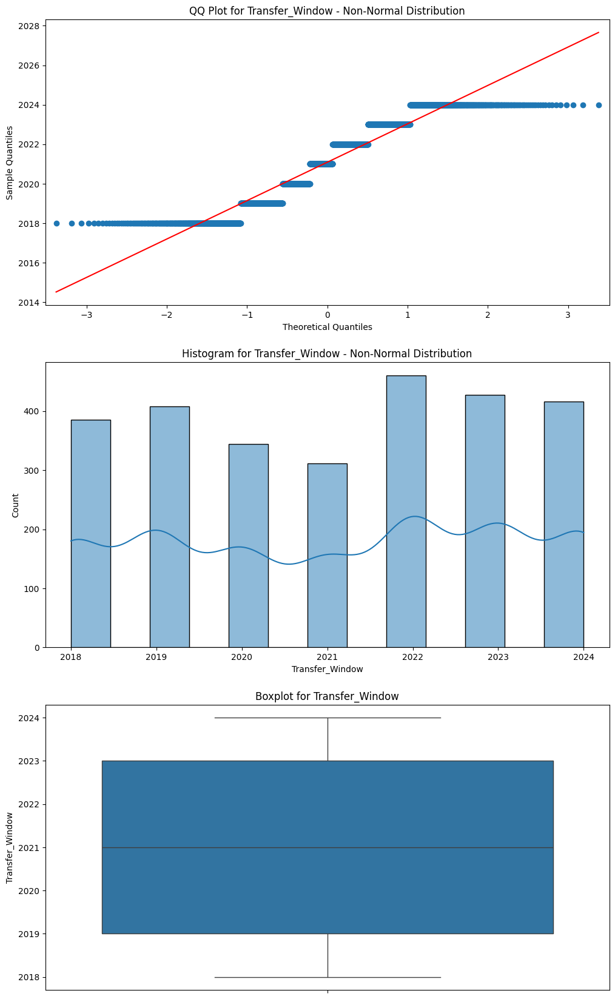

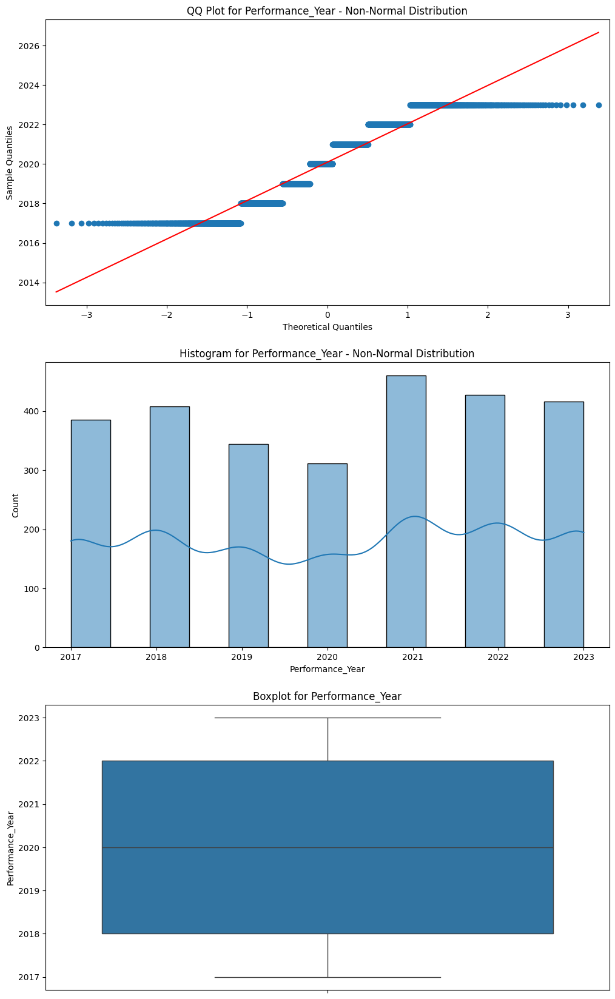

In [10]:
for i,x in enumerate(list(X_train_num.columns)):
    fig,axes=plt.subplots(3,1,figsize=(12,8))
    plt.subplots_adjust(top=2.0,bottom=0.0)

    result=anderson(X_train_num[x],dist='norm')
    #determine the significane level
    index=result.significance_level.tolist().index(5.0)
    cv=result.critical_values[index]

    #qqplot
    qqplot(X_train_num[x],line='r',ax=axes[0])
    axes[0].set_title(f'QQ Plot for {x} - {"Non-Normal Distribution" if result.statistic > cv else "Normal Distribution"}')

    #histogram
    sns.histplot(X_train_num[x],kde=True,ax=axes[1])
    axes[1].set_title(f'Histogram for {x} - {"Non-Normal Distribution" if result.statistic > cv else "Normal Distribution"}')

    #boxplot
    sns.boxplot(X_train_num[x],ax=axes[2])
    axes[2].set_title(f'Boxplot for {x}')

## Corrleation & Multicollinarity

In [ ]:
#here we get a list of features which could be filter out, because they are correlated too strong with other X features and have a weaker variance
##by using a set, we make sure not to add duplicate values to teh list
corr_matrix=X_train_num.corr(method='pearson').abs()
upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(bool))
to_drop=set()
for c in list(upper.columns):
    for x in list(upper.index):
        if upper.loc[x,c] >= 0.6:
            if X_train_num[c].var() > X_train_num[x].var():
                to_drop.add(x)
            else:
                to_drop.add(c)

print(f"Number of affected Columns that causes Multicollinarity: {len(to_drop)}")
print(f"Percentage of affected Features: {round((len(to_drop)/len(list(X_train_num.columns)))*100,2)}")

Number of affected Columns that causes Multicollinarity: 116
Percentage of affected Features: 81.69


In [92]:
#drop or replace inf and NaNs
X_train_num_clean=X_train_num.replace([np.inf,-np.inf],np.nan).dropna()

#add constant for intercept
x_vif=sm.add_constant(X_train_num_clean)

#compute VIF for each feature
vif_df=pd.DataFrame()
vif_df['Features']=X_train_num_clean.columns
vif_df['VIF']=[variance_inflation_factor(x_vif.values,i) for i in range(1,x_vif.shape[1])]

#handle 'inf' and high VIFs cleanly
vif_df['VIF']=pd.to_numeric(vif_df['VIF'],errors='coerce')
high_vif_df=vif_df[vif_df['VIF']>10].sort_values('VIF',ascending=False)
inf_vif_df=vif_df[vif_df['VIF']==float('inf')]

VIF=pd.concat([high_vif_df,inf_vif_df]).drop_duplicates()
#Note => we do not need to check for multicollinarity
print(f"Number of affected Columns that causes Multicollinarity: {len(VIF)}")
print(f"Percentage of affected Features: {round((len(VIF)/len(X_train_num.columns))*100,2)}")
VIF

c:\Users\gandj\OneDrive\Desktop\Case_Study\Football\Transfers\Transfer_Target_Model\venv\Lib\site-packages\statsmodels\stats\outliers_influence.py:197: RuntimeWarning: divide by zero encountered in scalar divide
  vif = 1. / (1. - r_squared_i)


Number of affected Columns that causes Multicollinarity: 122
Percentage of affected Features: 85.92


,Features,VIF
4,Gls,inf
5,Ast,inf
8,PK,inf
6,G+A,inf
7,G-PK,inf
14,xAG,inf
24,G+A-PK_per_90,inf
18,PrgR,inf
19,G+A-PK,inf
30,Total Tackels,inf


We are dealing with multicollinarity and should keep it in mind, when the model is not performing well, when not addressing multicollinarity.

# Categorical Features
In the following section, we will check how the y feature behaves, and we will perform some feature engineering.

## Basic y Feature Analysis

In [93]:
#dropping the player column, will not contribute, cardinality is too high
X_train_cat.drop(['Player','Squad','League'],axis=1,inplace=True)

X_train_cat.head()

,Nation,Pos,Age,Club_Left,League_Left
2666,EGY,MF,Early Twenties,Huddersfield Town,Premier League
7,GBR,GK,Late Twenties,FC Arsenal,Premier League
300,ITA,DF,Early Thirties,Inter Mailand,Serie A
339,BEL,MF,Teenager,Atlético Madrid,LaLiga
4,AUT,MF,Late Twenties,Brighton & Hove Albion,Premier League


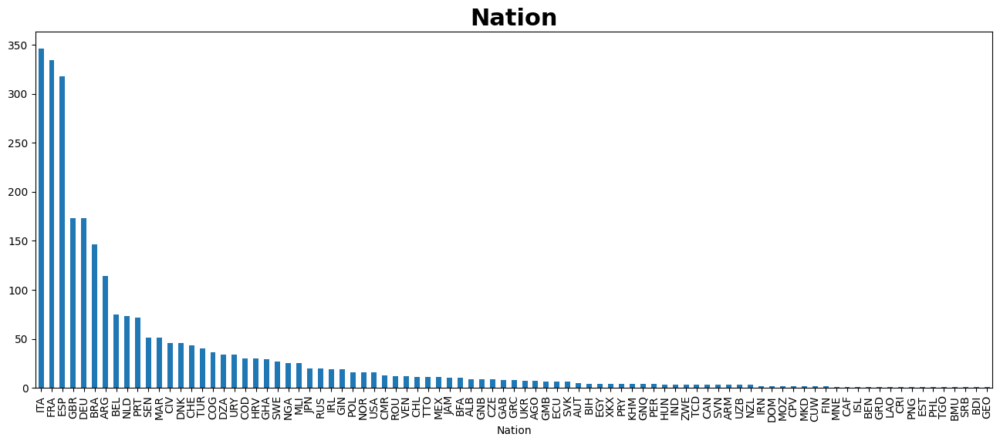

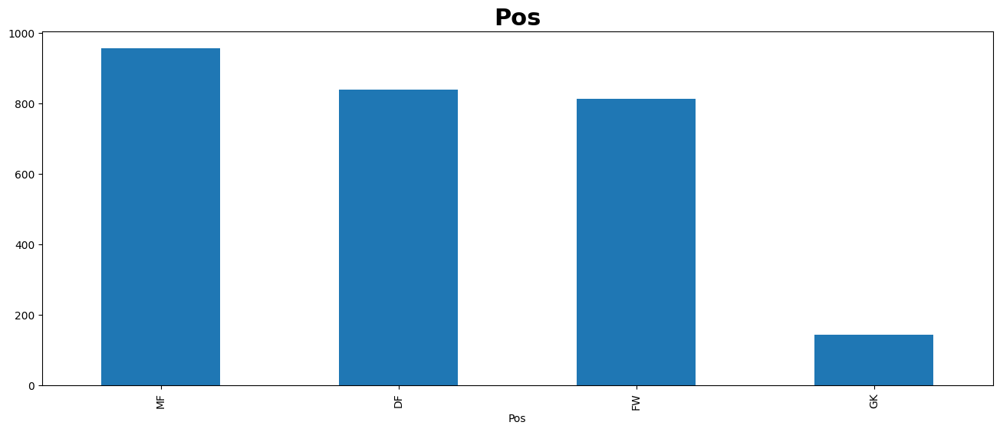

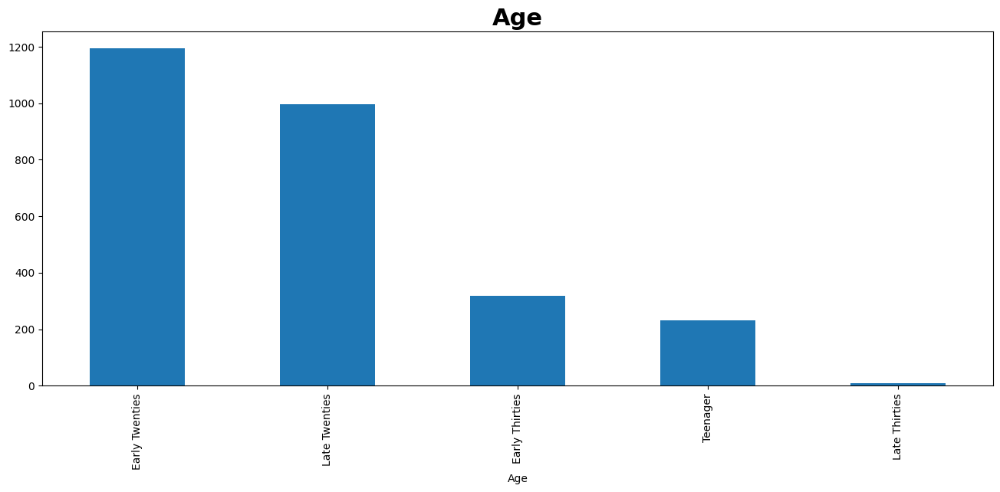

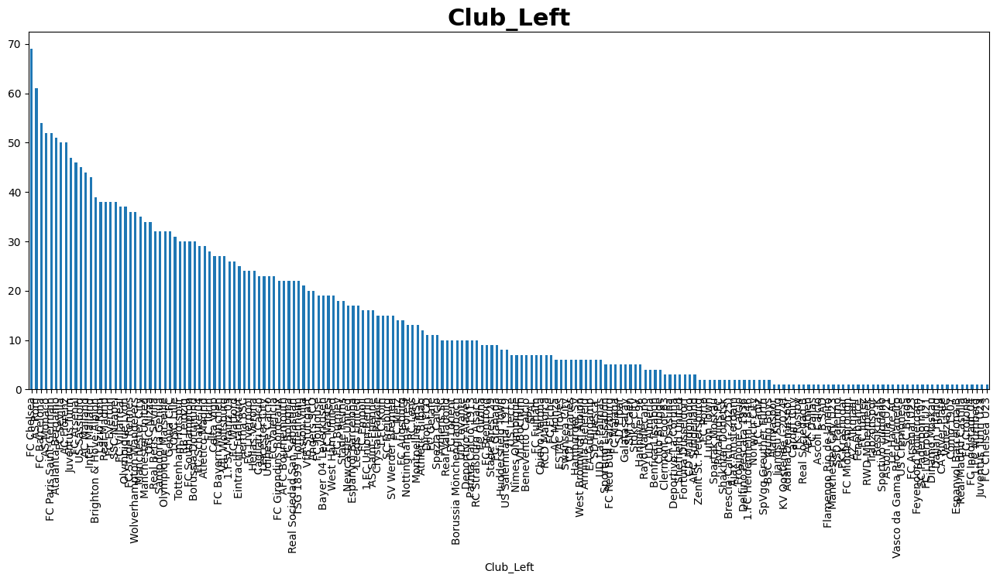

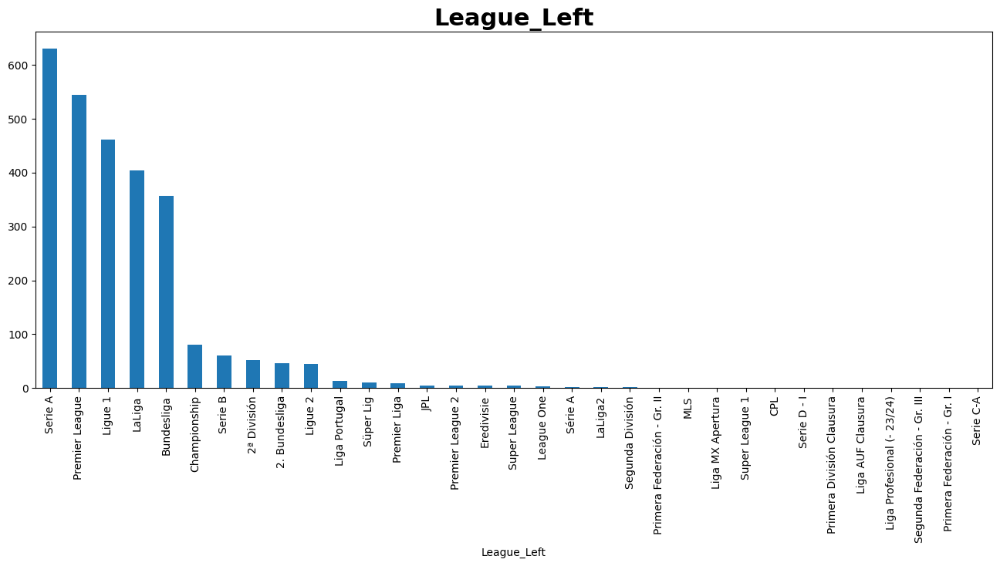

In [94]:
for c in X_train_cat.columns:
    plt.figure(figsize=(16, 6))
    X_train_cat[c].value_counts().plot(kind='bar')
    plt.title(c,size=22,fontweight='bold')

Text(0.5, 1.0, 'Y Feature')

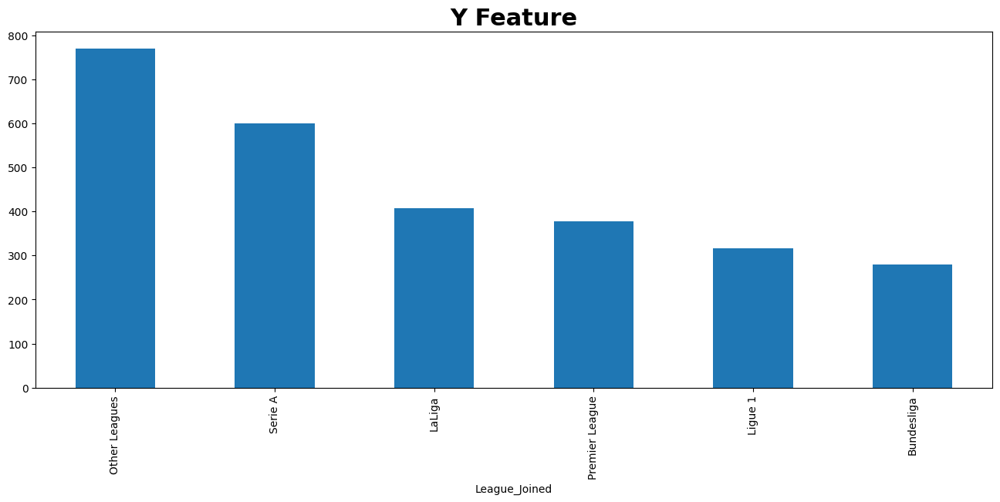

In [95]:
y_train.value_counts().plot(kind='bar',figsize=(16, 6))
plt.title('Y Feature',size=22,fontweight='bold')

By inspecting the graphs, we can notice following aspects:
- The cardinality for Nations is very high => we should try to bin and target encode them first, if that is not leading to a good model performance, we can adjust the "Cleaning.py" and combine countries into continents
- Positions => we have just four positions, we will address them by using One-Hot Encoding
- Club_Left => we need to bin and create target encoding
- League_Left => we will bin and create target encoding

Target encoding allows us to encode the probability of the class to the categorical feature that will be encoded. This approach is much better suited than mean encoding, which is better for regression problems.

Next, we get the counts of the target classes, and categorical values that need to be binned.

## Feature Engineering

In [96]:
((y_train.value_counts()/len(y_train))*100).to_frame().reset_index().rename(columns={'count':'Percentage of Appearance'})

,League_Joined,Percentage of Appearance
0,Other Leagues,27.989822
1,Serie A,21.773900
2,LaLiga,14.830971
3,Premier League,13.704108
4,Ligue 1,11.523083
5,Bundesliga,10.178117


The target feature is mildy imbalanced, but this can be addressed by using macro F1 Score, focusing on precision and recall of each class and we can add class weights.

In [17]:
for cat in X_train_cat.columns:
    print((X_train_cat[cat].value_counts()/len(X_train_cat))*100)
    print('\n')

Nation
ITA    12.577245
FRA    12.141040
ESP    11.559433
GBR     6.288622
DEU     6.288622
BRA     5.307161
ARG     4.143948
BEL     2.726281
NLD     2.653581
PRT     2.617230
SEN     1.853871
MAR     1.853871
CIV     1.672119
DNK     1.672119
CHE     1.563068
TUR     1.454017
COG     1.308615
DZA     1.235914
URY     1.235914
COD     1.090513
HRV     1.090513
GHA     1.054162
SWE     0.981461
NGA     0.908760
MLI     0.908760
JPN     0.727008
RUS     0.727008
IRL     0.690658
GIN     0.690658
POL     0.581607
NOR     0.581607
USA     0.581607
CMR     0.472555
ROU     0.436205
VEN     0.436205
CHL     0.399855
TTO     0.399855
MEX     0.399855
JAM     0.363504
BFA     0.363504
ALB     0.327154
GNB     0.327154
CZE     0.327154
GAB     0.290803
GRC     0.290803
UKR     0.254453
AGO     0.254453
GMB     0.218103
ECU     0.218103
SVK     0.218103
AUT     0.181752
BIH     0.145402
EGY     0.145402
XKX     0.145402
PRY     0.145402
KHM     0.145402
GNQ     0.145402
PER     0.145402
HUN    

We will us following binning threshold:
- Nation => everything equal or below 0.005 will be binned => which should lead to rare labels of 9.2% (till 15%, okay; exceeding 20% is bad)
- Club_Left => everyting equal or below 0.0025 will be binned => which should lead to rare labels of 9.2% (till 15%, okay; exceeding 20% is bad)
- League_Left => everything below 0.001 will be binned => which should lead to rare labels of 9.2% (till 15%, okay; exceeding 20% is bad)

We need to keep in mind, that we need three different transformer to do that.

In [18]:
rare_nation=RareLabelEncoder(tol=0.005,variables='Nation')
adjusted_nation_X_train_cat=rare_nation.fit_transform(X_train_cat)
for cat in adjusted_nation_X_train_cat.columns:
    print((adjusted_nation_X_train_cat[cat].value_counts()/len(adjusted_nation_X_train_cat))*100)
    print('\n')

Nation
ITA     12.577245
FRA     12.141040
ESP     11.559433
Rare     9.233006
GBR      6.288622
DEU      6.288622
BRA      5.307161
ARG      4.143948
BEL      2.726281
NLD      2.653581
PRT      2.617230
SEN      1.853871
MAR      1.853871
CIV      1.672119
DNK      1.672119
CHE      1.563068
TUR      1.454017
COG      1.308615
DZA      1.235914
URY      1.235914
HRV      1.090513
COD      1.090513
GHA      1.054162
SWE      0.981461
NGA      0.908760
MLI      0.908760
JPN      0.727008
RUS      0.727008
GIN      0.690658
IRL      0.690658
USA      0.581607
POL      0.581607
NOR      0.581607
Name: count, dtype: float64


Pos
MF    34.75100
DF    30.46165
FW    29.55289
GK     5.23446
Name: count, dtype: float64


Age
Early Twenties    43.402399
Late Twenties     36.241367
Early Thirties    11.595783
Teenager           8.396947
Late Thirties      0.363504
Name: count, dtype: float64


Club_Left
FC Chelsea                      2.508179
AS Rom                          2.217375
FC Barcel

In [19]:
cl_rare=RareLabelEncoder(tol=0.0025,variables=['Club_Left'])
adjusted_cl_X_train_cat=cl_rare.fit_transform(adjusted_nation_X_train_cat)
for cat in adjusted_cl_X_train_cat.columns:
    print((adjusted_cl_X_train_cat[cat].value_counts()/len(adjusted_cl_X_train_cat))*100)
    print('\n')

Nation
ITA     12.577245
FRA     12.141040
ESP     11.559433
Rare     9.233006
GBR      6.288622
DEU      6.288622
BRA      5.307161
ARG      4.143948
BEL      2.726281
NLD      2.653581
PRT      2.617230
SEN      1.853871
MAR      1.853871
CIV      1.672119
DNK      1.672119
CHE      1.563068
TUR      1.454017
COG      1.308615
DZA      1.235914
URY      1.235914
HRV      1.090513
COD      1.090513
GHA      1.054162
SWE      0.981461
NGA      0.908760
MLI      0.908760
JPN      0.727008
RUS      0.727008
GIN      0.690658
IRL      0.690658
USA      0.581607
POL      0.581607
NOR      0.581607
Name: count, dtype: float64


Pos
MF    34.75100
DF    30.46165
FW    29.55289
GK     5.23446
Name: count, dtype: float64


Age
Early Twenties    43.402399
Late Twenties     36.241367
Early Thirties    11.595783
Teenager           8.396947
Late Thirties      0.363504
Name: count, dtype: float64


Club_Left
Rare                           7.669938
FC Chelsea                     2.508179
AS Rom     

In [20]:
ll_rare=RareLabelEncoder(tol=0.002,variables=['League_Left'])
adjusted_ll_X_train_cat=ll_rare.fit_transform(adjusted_cl_X_train_cat)
for cat in adjusted_ll_X_train_cat.columns:
    print((adjusted_ll_X_train_cat[cat].value_counts()/len(adjusted_ll_X_train_cat))*100)
    print('\n')

Nation
ITA     12.577245
FRA     12.141040
ESP     11.559433
Rare     9.233006
GBR      6.288622
DEU      6.288622
BRA      5.307161
ARG      4.143948
BEL      2.726281
NLD      2.653581
PRT      2.617230
SEN      1.853871
MAR      1.853871
CIV      1.672119
DNK      1.672119
CHE      1.563068
TUR      1.454017
COG      1.308615
DZA      1.235914
URY      1.235914
HRV      1.090513
COD      1.090513
GHA      1.054162
SWE      0.981461
NGA      0.908760
MLI      0.908760
JPN      0.727008
RUS      0.727008
GIN      0.690658
IRL      0.690658
USA      0.581607
POL      0.581607
NOR      0.581607
Name: count, dtype: float64


Pos
MF    34.75100
DF    30.46165
FW    29.55289
GK     5.23446
Name: count, dtype: float64


Age
Early Twenties    43.402399
Late Twenties     36.241367
Early Thirties    11.595783
Teenager           8.396947
Late Thirties      0.363504
Name: count, dtype: float64


Club_Left
Rare                           7.669938
FC Chelsea                     2.508179
AS Rom     

In [21]:
ohe_X=OneHotEncoder(drop_last=False,variables=['Pos','Age'])
adjusted_ohe_X_train_cat=ohe_X.fit_transform(adjusted_ll_X_train_cat)
for cat in adjusted_ohe_X_train_cat.columns:
    print((adjusted_ohe_X_train_cat[cat].value_counts()/len(adjusted_ohe_X_train_cat))*100)
    print('\n')

Nation
ITA     12.577245
FRA     12.141040
ESP     11.559433
Rare     9.233006
GBR      6.288622
DEU      6.288622
BRA      5.307161
ARG      4.143948
BEL      2.726281
NLD      2.653581
PRT      2.617230
SEN      1.853871
MAR      1.853871
CIV      1.672119
DNK      1.672119
CHE      1.563068
TUR      1.454017
COG      1.308615
DZA      1.235914
URY      1.235914
HRV      1.090513
COD      1.090513
GHA      1.054162
SWE      0.981461
NGA      0.908760
MLI      0.908760
JPN      0.727008
RUS      0.727008
GIN      0.690658
IRL      0.690658
USA      0.581607
POL      0.581607
NOR      0.581607
Name: count, dtype: float64


Club_Left
Rare                           7.669938
FC Chelsea                     2.508179
AS Rom                         2.217375
FC Barcelona                   1.962923
FC Paris Saint-Germain         1.890222
AS Monaco                      1.890222
Atalanta Bergamo               1.853871
AC Florenz                     1.817521
FC Sevilla                     1.817521

In [22]:
tar_code=TargetEncoder(cols=['Nation','Club_Left','League_Left'])
tar_code.fit(adjusted_ohe_X_train_cat,y_train)
adjusted_mean_X_train_cat=tar_code.transform(adjusted_ohe_X_train_cat)
for cat in adjusted_mean_X_train_cat.columns:
    print((adjusted_mean_X_train_cat[cat].value_counts()/len(adjusted_mean_X_train_cat))*100)
    print('\n')

Nation
4.202312    12.577245
2.520958    12.141040
1.993711    11.559433
2.925197     9.233006
3.352601     6.288622
1.236995     6.288622
2.842466     5.307161
2.868420     4.143948
2.946295     2.726281
3.012912     2.653581
2.833454     2.617230
3.068814     1.853871
2.843663     1.853871
2.706692     1.672119
3.050706     1.672119
2.521810     1.563068
2.674475     1.454017
3.021921     1.308615
2.947787     1.235914
2.924194     1.235914
3.063877     1.163213
2.863617     1.090513
3.350989     1.090513
3.448492     1.054162
3.471697     0.981461
3.094770     0.908760
2.696396     0.908760
2.302663     0.727008
3.052663     0.727008
2.524031     0.690658
3.074055     0.690658
2.988631     0.581607
Name: count, dtype: float64


Club_Left
2.502370    7.669938
3.114016    2.508179
3.368544    2.217375
2.439794    1.962923
2.809558    1.890222
2.754125    1.890222
3.931894    1.853871
3.793301    1.817521
2.269182    1.817521
3.688675    1.708470
3.131650    1.672119
4.139068    1.6357

## Linearity
Next, we will check if the numerical features (also encoded features) have a linear trend with the y feature.

In [23]:
adjusted_mean_X_train_cat.head()

,Nation,Club_Left,League_Left,Pos_MF,Pos_GK,Pos_DF,Pos_FW,Age_Early Twenties,Age_Late Twenties,Age_Early Thirties,Age_Teenager,Age_Late Thirties
2666,2.925197,2.888814,2.902574,1,0,0,0,1,0,0,0,0
7,3.352601,3.131650,2.902574,0,1,0,0,0,1,0,0,0
300,4.202312,3.599780,3.833333,0,0,1,0,0,0,1,0,0
339,2.946295,2.663996,2.349010,1,0,0,0,0,0,0,1,0
4,2.925197,2.378944,2.902574,1,0,0,0,0,1,0,0,0


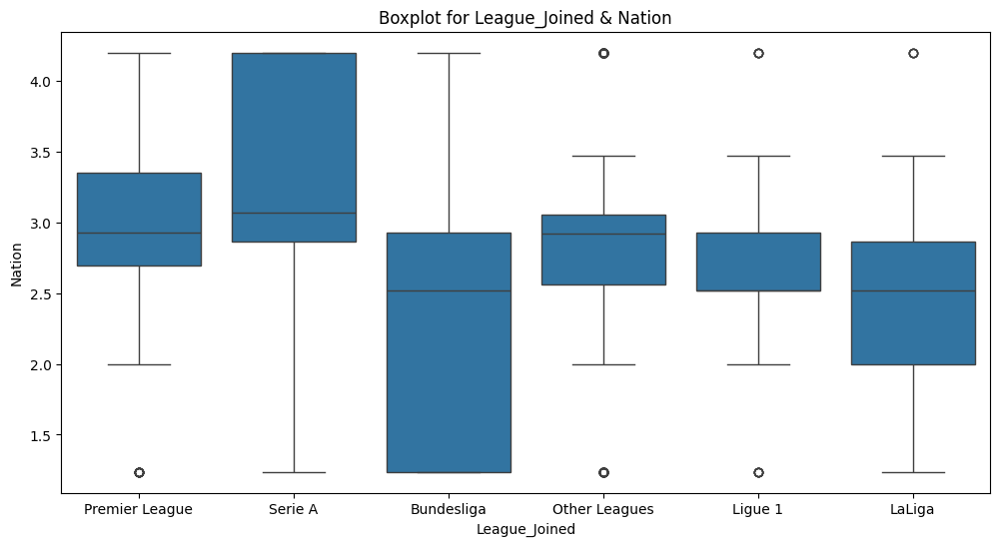

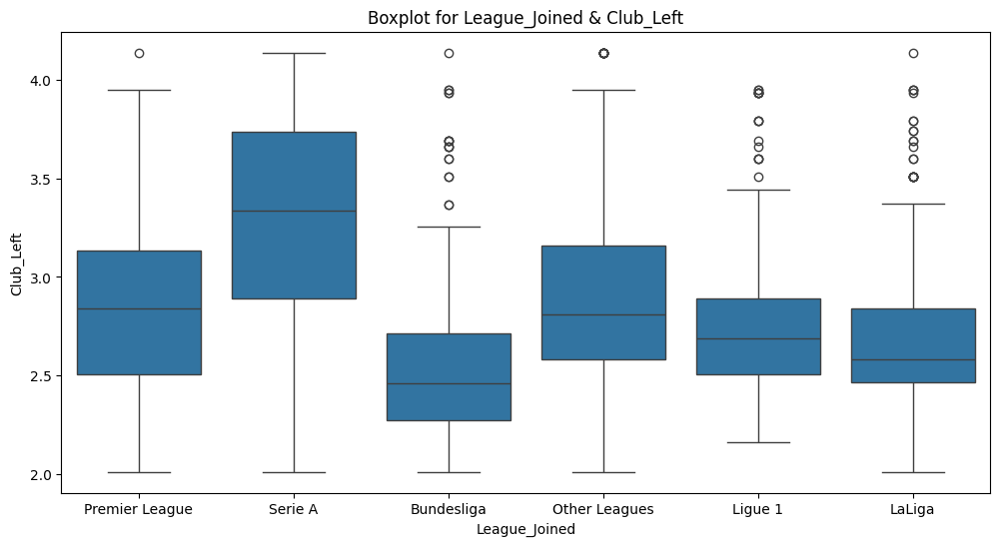

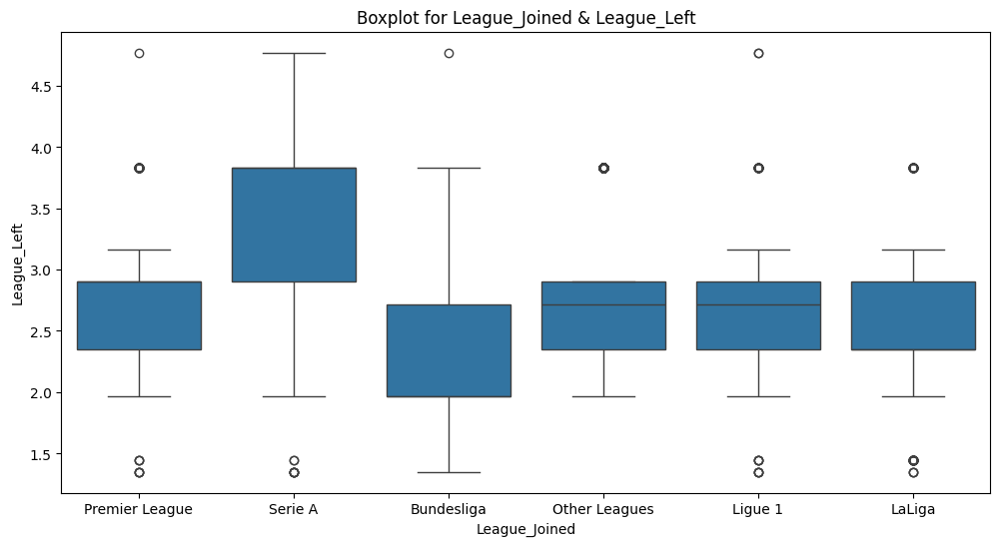

In [24]:
df_median_encoded = adjusted_mean_X_train_cat.copy()
df_median_encoded['y_train'] = y_train

for ec in ['Nation','Club_Left','League_Left']:
    plt.figure(figsize=(12,6))
    sns.boxplot(x=y_train,y=adjusted_mean_X_train_cat[ec])
    plt.title(f'Boxplot for League_Joined & {ec}')

In [25]:
for ec in ['Nation','Club_Left','League_Left']:
    print(f'{ec}')
    print(df_median_encoded.groupby('y_train')[ec].agg(
        q25=lambda x: x.quantile(0.25),
        median='median',
        q75=lambda x: x.quantile(0.75)
    ))
    print('\n')
    print('\n')

Nation
                     q25    median       q75
y_train                                     
Bundesliga      1.236995  2.520958  2.925197
LaLiga          1.993711  2.520958  2.868420
Ligue 1         2.520958  2.521810  2.925197
Other Leagues   2.561642  2.924194  3.052173
Premier League  2.696396  2.925197  3.352601
Serie A         2.868420  3.068814  4.202312




Club_Left
                     q25    median       q75
y_train                                     
Bundesliga      2.273833  2.456897  2.710492
LaLiga          2.463928  2.582249  2.838530
Ligue 1         2.502370  2.687647  2.888814
Other Leagues   2.578337  2.809268  3.158098
Premier League  2.502370  2.838530  3.131650
Serie A         2.888481  3.338045  3.737657




League_Left
                     q25    median       q75
y_train                                     
Bundesliga      1.966387  1.966387  2.713666
LaLiga          2.349010  2.349010  2.902574
Ligue 1         2.349010  2.713666  2.902574
Other Leagues   2.

Club_Left and Nation show some different patterns when it comes to the different classes that we attempt to predict. League Left on the other hand does not provide that much insight,because we do not see that much seperation between the different classes.

Next, we will encode the target feature via one hot encode and measure the correlation levels between the target encoded features.

In [26]:
ohe_y = OneHotEncoder(drop_last=False, variables=['y_train'])
corr_ohe_df = ohe_y.fit_transform(df_median_encoded)

point_corr=[]
for ec in ['Nation','Club_Left','League_Left']:
    for ohe in ['y_train_Ligue 1','y_train_LaLiga', 'y_train_Premier League', 'y_train_Serie A','y_train_Bundesliga', 'y_train_Other Leagues']:
        stats,p_value=pointbiserialr(corr_ohe_df[ec],corr_ohe_df[ohe])

        point_corr.append(
            {
                "Combinations":f"{ec}-{ohe}",
                "Correlation Level":stats,
                "P-Value":p_value
            }
        )
point_corr_df=pd.DataFrame(point_corr)
point_corr_df[point_corr_df['P-Value']<0.05]

,Combinations,Correlation Level,P-Value
0,Nation-y_train_Ligue 1,-0.069675,2.549363e-04
1,Nation-y_train_LaLiga,-0.213558,9.654550e-30
3,Nation-y_train_Serie A,0.398322,2.848416e-105
4,Nation-y_train_Bundesliga,-0.254081,8.677326e-42
6,Club_Left-y_train_Ligue 1,-0.097606,2.907530e-07
7,Club_Left-y_train_LaLiga,-0.173684,4.498540e-20
9,Club_Left-y_train_Serie A,0.426509,4.973084e-122
10,Club_Left-y_train_Bundesliga,-0.233773,1.832680e-35
12,League_Left-y_train_Ligue 1,-0.096986,3.457957e-07
13,League_Left-y_train_LaLiga,-0.181539,8.210698e-22


We do want moderate correlation between features and the target, because it means the feature helps the model distinguish between classes.
However, we do not want strong correlation between different features, because that leads to redundancy and less diverse learning.

In [27]:
step_df=pd.concat([X_train_num,adjusted_mean_X_train_cat],axis=1)
final_adjust_df=pd.concat([step_df,y_train],axis=1)
final_adjust_df.head()

,MP,Starts,Min,90s,Gls,Ast,G+A,G-PK,PK,PKatt,CrdY,CrdR,xG,npxG,xAG,npxG+xAG,PrgC,PrgP,PrgR,G+A-PK,Gls_per_90,Ast_per_90,G+A_per_90,G-PK_per_90,G+A-PK_per_90,xG_per_90,xAG_per_90,xG+xAG_per_90,npxG_per_90,npxG+xAG_per_90,Total Tackels,TklW,Def 3rd,Mid 3rd,Att 3rd,Dribblers_Tackeld,Dribblers_Tackel_Att,Dribblers_Tackel%,Lost,Blocks,Sh,Pass,Int,Tkl+Int,Clr,Err,Total_Att,Total_Cmp%,TotDist,PrgDist,Short_Cmp,Short_Att,Short_Cmp%,Medium_Cmp,Medium_Att,Medium_Cmp%,Long_Cmp,Long_Att,Long_Cmp%,xA,A-xAG,KP,1/3,PPA,CrsPA,Touches,Touches_Def_Pen_Area,Touches_Def_3rd_Area,Touches_Mid_3rd_Area,Touches_Att_3rd_Area,Touches_Att_Pen_Area,Live_Touches_in_Game,Dribbling_Att,Dribbling_Succ,Dribbling_Succ%,Tackeld_Dribbling,Tackeld_Dribbling%,Total_Carry_Distance,Total_Progressive_Carry_Distance,Total_Carries_in_1/3,Total_Carries_in_Penalty_Area,Miscontrols_Carries,Dispossed_Carries,Passes_Received,Progressive_Passes_Received,Shot_Creating_Action,Shot_Creating_Action_90,Live_Passes_lead_Shot_Att,Dead_Passes_lead_Shot_Att,Shot_Att_after_Dribbling,Shot_lead_to_Shot_Att,Foul_drawn_lead_Shot_Att,Def_Action_lead_Shot_Att,GCA,GCA90,Live_Pass_lead_Goal,Dead_Pass_lead_Goal,Goal_after_Dribbling,Shot_lead_Goal,Foul_drawn_lead_Goal,Def_Action_lead_Goal,GA,GA90,SoTA,Saves,Save%,W,D,L,CS,CS%,PKA,PKsv,PKm,Penalty_Kick_Saves,FK,CK,OG,PSxG,PSxG/SoT,PSxG+/-,/90,Cmp,Att,Cmp%,Att (GK),Thr,Launch%_Passes,AvgLen_Passes,Goal_Kick_Att,Launch%_Goal_Kicks,AvgLen_Goal_Kicks,Opp,Stp,Stp%,#OPA,#OPA/90,AvgDist,Limited_Time,Age_Num,Transfer_Window,Performance_Year,Nation,Club_Left,League_Left,Pos_MF,Pos_GK,Pos_DF,Pos_FW,Age_Early Twenties,Age_Late Twenties,Age_Early Thirties,Age_Teenager,Age_Late Thirties,League_Joined
2666,24.0,12.0,1238.0,13.8,2.0,0.0,2.0,2.0,0.0,0.0,2.0,0.0,1.2,1.2,1.0,2.2,58.0,38.000000,102.0,0.15,0.15,0.00,0.15,0.15,0.15,0.09,0.07,0.16,0.09,0.16,32.0,21.0,17.0,14.0,1.0,11.0,36.0,30.6,25.0,14.0,0.0,14.0,14.0,46.0,14.0,0.000000,452.000000,75.200000,4533.0,1308.000000,206.000000,250.000000,82.400000,99.000000,130.000000,76.2,11.000000,19.000000,57.9,1.1,-1.0,15.0,19.000000,15.0,2.0,600.000000,9.000000,107.0,245.000000,267.0,37.0,600.000000,51.0,30.0,58.8,21.0,41.2,3143.000000,1811.0,40.0,18.0,26.000000,20.0,403.000000,102.0,26.0,1.89,22.0,0.0,2.0,1.0,0.0,1.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.0,0.0,0.000000,0.0,20.0,2018,2017.0,2.925197,2.888814,2.902574,1,0,0,0,1,0,0,0,0,Premier League
7,4.0,4.0,360.0,4.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.333333,0.0,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,1.333333,125.333333,46.466667,2202.0,1613.333333,25.333333,25.333333,66.666667,40.666667,41.333333,65.6,21.333333,57.333333,24.8,0.0,0.0,0.0,2.666667,0.0,0.0,131.333333,93.333333,124.0,7.333333,0.0,0.0,131.333333,0.0,0.0,0.0,0.0,0.0,464.666667,266.0,0.0,0.0,0.666667,0.0,69.333333,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,3.333333,0.553333,9.333333,6.0,42.866667,3.333333,0.666667,0.0,1.333333,22.2,0.0,0.0,0.0,0.0,0.0,0.666667,0.0,2.466667,0.173333,-0.866667,-0.146667,12.666667,46.0,18.333333,112.666667,20.0,23.266667,22.2,12.666667,35.066667,27.6,30.666667,5.333333,11.6,6.0,1.0,9.733333,1.0,25.0,2024,2023.0,3.352601,3.131650,2.902574,0,1,0,0,0,1,0,0,0,Premier League
300,32.0,24.0,1993.0,22.1,5.0,7.0,12.0,5.0,0.0,0.0,5.0,0.0,2.3,2.3,5.3,7.6,80.0,104.000000,221.0,0.54,0.23,0.32,0.54,0.23,0.54,0.10,0.24,0.34,0.10,0.34,11.0,6.0,9.0,1.0,1.0,7.0,29.0,24.1,22.0,26.0,10.0,16.0,14.0,25.0,33.0,1.000000,1368.000000,76.100000,19184.0,6030.000000,496.000000,550.000000,90.200000,399.000000,516.000000,77.3,130.000000,229.000000,56.8,5.0,1.7,47.0,72.000000,59.0,27.0,1553.000000,53.000000,326.0,608.000000,630.0,57.0,1553.000000,21.0,10.0,

MP
                      q25   variance       mean  median    q75
League_Joined                                                 
Bundesliga      15.875000  74.450824  21.439167    22.0  29.00
LaLiga          15.083333  94.268912  22.115332    22.8  30.75
Ligue 1         14.000000  88.489770  21.178864    22.0  29.00
Other Leagues   11.000000  83.809755  18.162677    18.0  25.00
Premier League  16.000000  89.150852  22.822826    24.0  31.00
Serie A         14.000000  86.952194  20.842951    22.0  28.00




Starts
                     q25    variance       mean     median     q75
League_Joined                                                     
Bundesliga      8.000000   91.872318  15.869028  14.833333  23.000
LaLiga          8.375000  105.374188  16.914965  17.000000  24.625
Ligue 1         8.000000   94.225888  15.802787  16.000000  24.000
Other Leagues   4.333333   77.744224  11.784942  10.000000  18.000
Premier League  9.000000  103.799999  18.135293  18.000000  27.000
Serie A      

C:\Users\gandj\AppData\Local\Temp\ipykernel_60040\3126455136.py:9: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(12,6))


Ast_per_90
                q25  variance      mean    median       q75
League_Joined                                              
Bundesliga      0.0  0.020695  0.099004  0.053333  0.140000
LaLiga          0.0  0.026217  0.098633  0.070000  0.140833
Ligue 1         0.0  0.015411  0.092690  0.060000  0.140000
Other Leagues   0.0  0.026483  0.096001  0.040000  0.130000
Premier League  0.0  0.012339  0.091807  0.060000  0.140000
Serie A         0.0  0.016037  0.092063  0.055000  0.135833




G+A_per_90
                    q25  variance      mean  median       q75
League_Joined                                                
Bundesliga      0.07000  0.083429  0.273938   0.195  0.410000
LaLiga          0.04375  0.064569  0.236476   0.165  0.351250
Ligue 1         0.04000  0.062351  0.240046   0.175  0.370000
Other Leagues   0.00000  0.068174  0.228261   0.150  0.354583
Premier League  0.04500  0.063122  0.241683   0.160  0.390000
Serie A         0.05000  0.068672  0.242776   0.180  0.36750

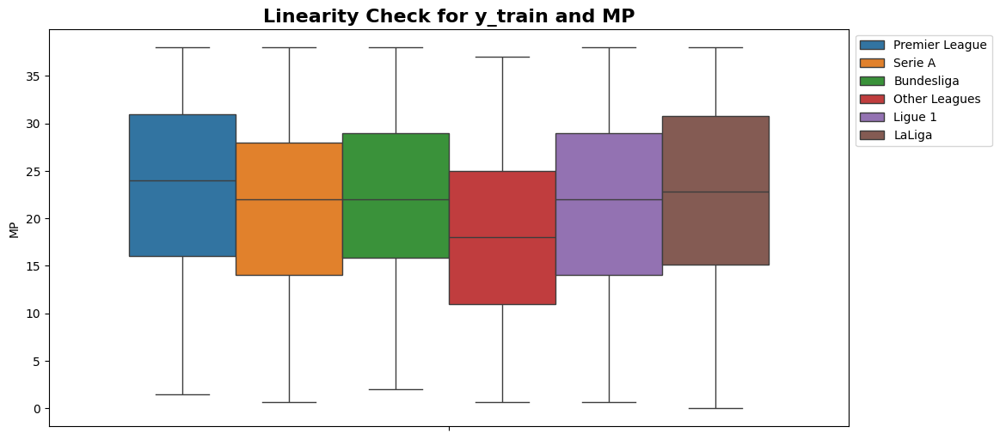

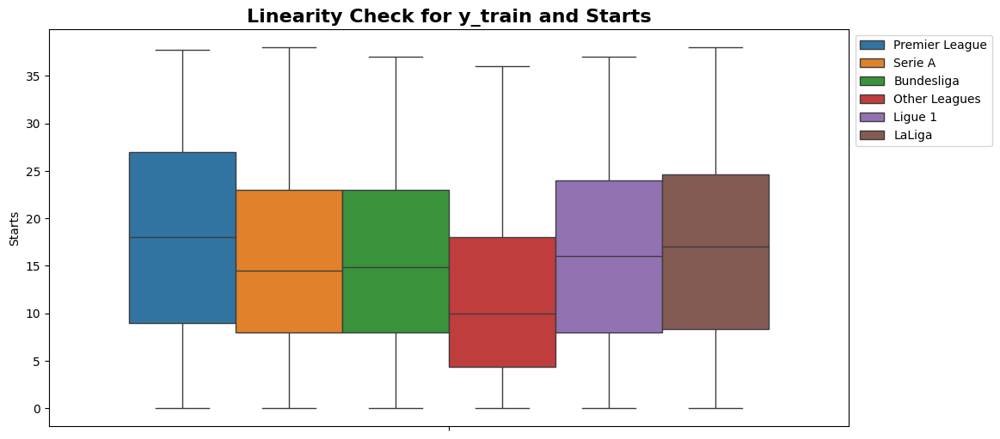

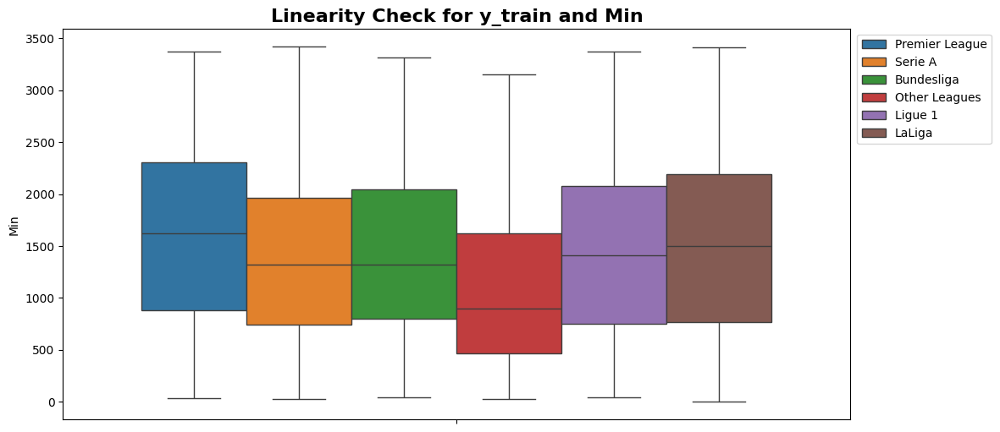

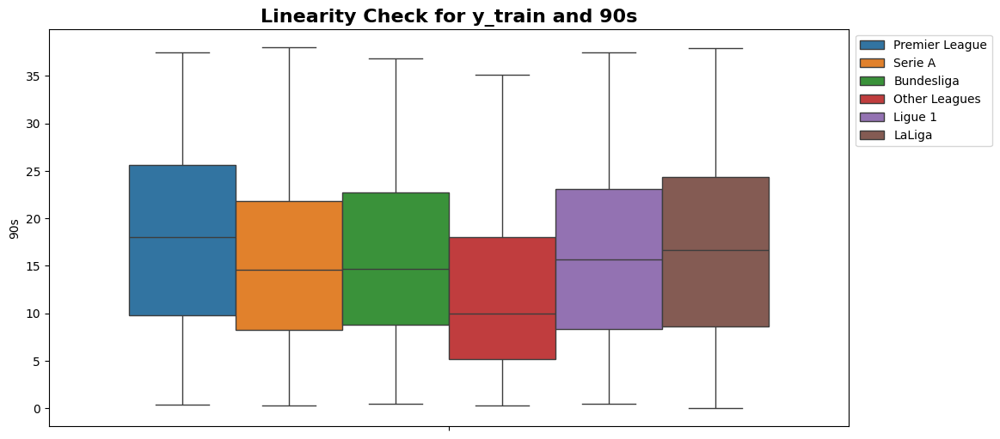

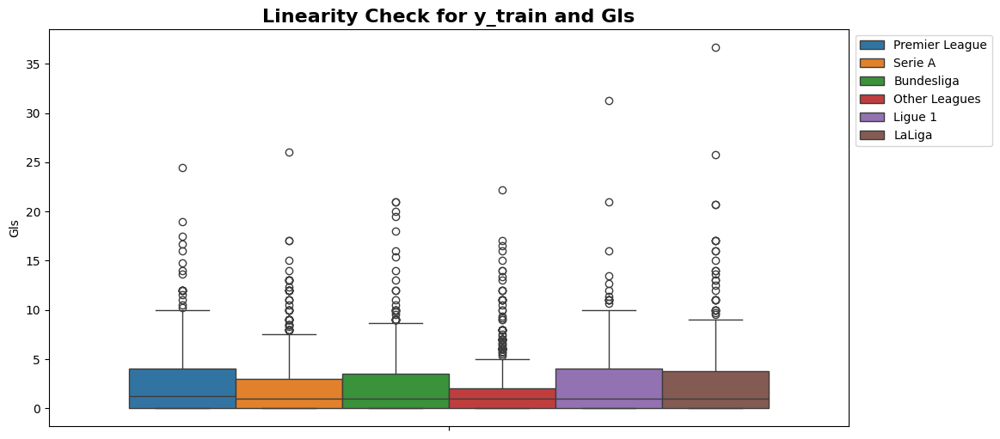

...

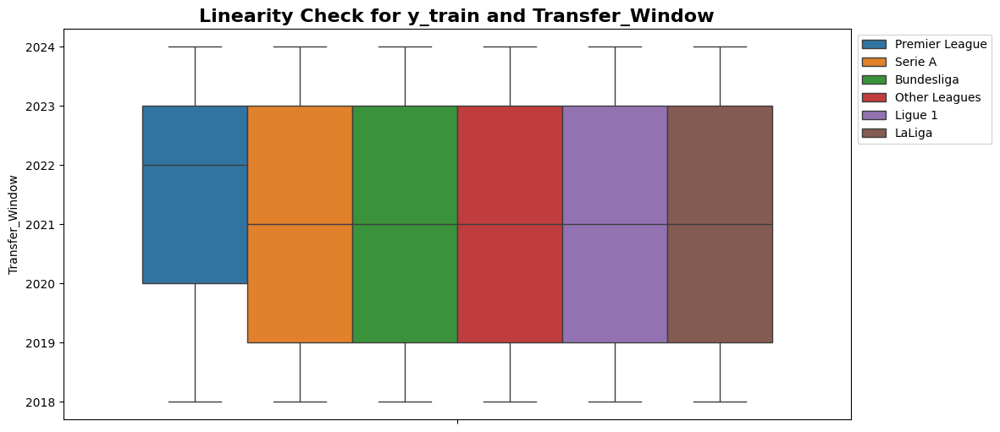

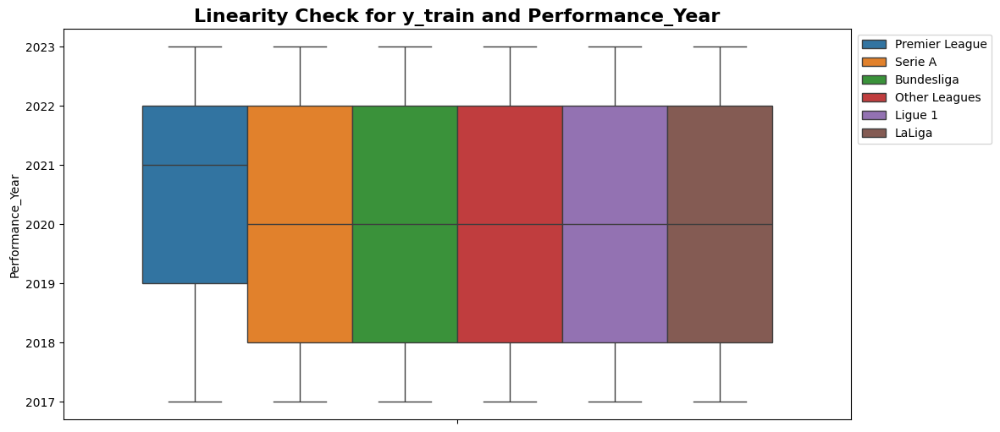

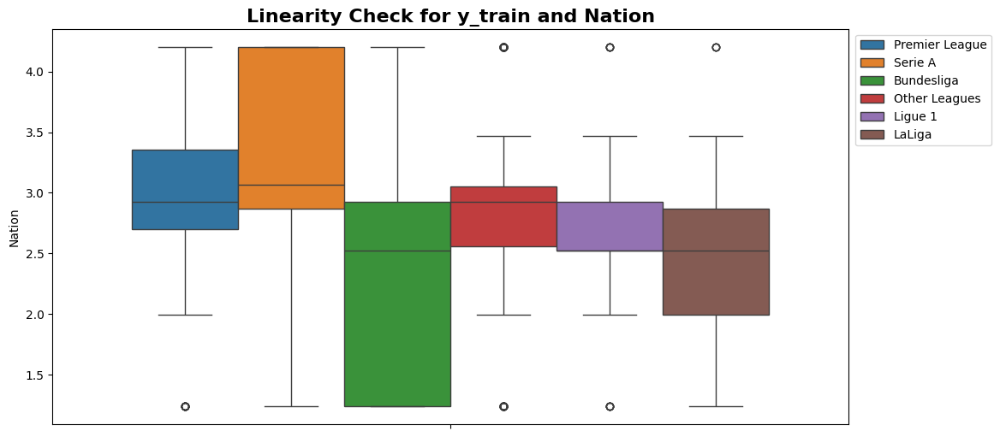

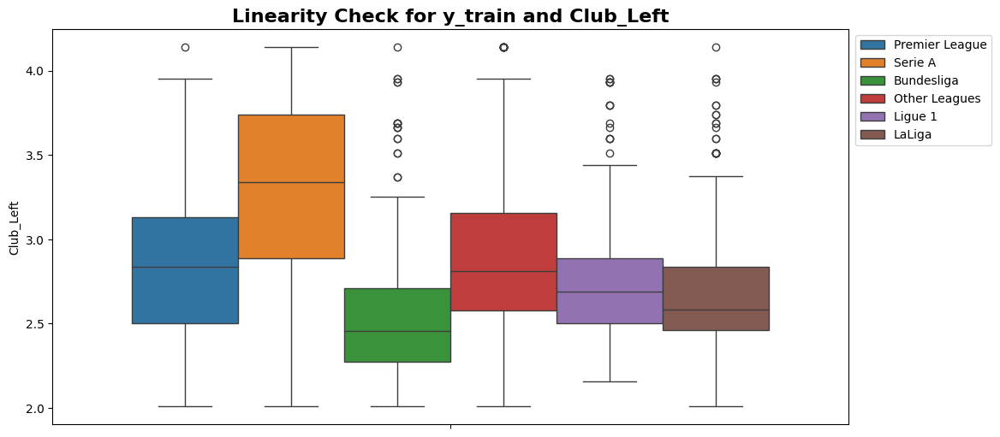

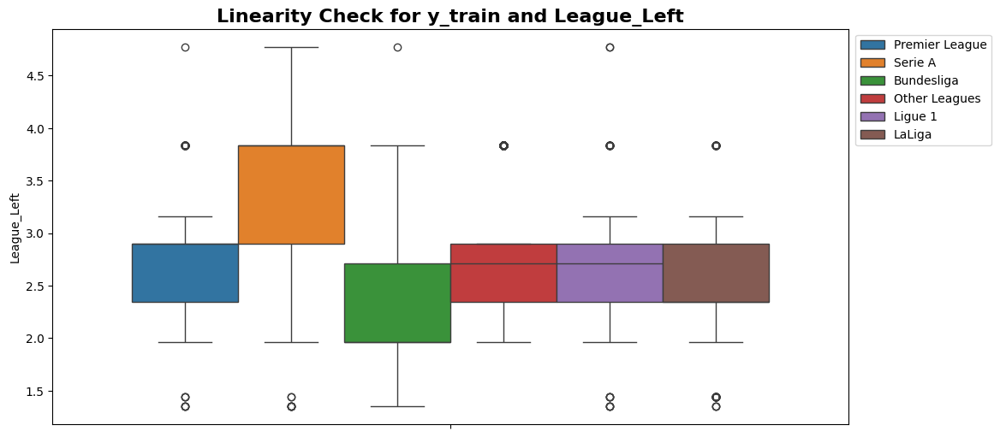

In [28]:
x_feat=list(final_adjust_df.columns)
for d in ['Pos_MF','Pos_FW','Pos_GK','Pos_DF','Age_Early Twenties','Age_Late Twenties','Age_Teenager','Age_Early Thirties','Age_Late Thirties']:
    x_feat.remove(d)

for x in x_feat:
    if x == 'League_Joined':
        continue
    else:
        plt.figure(figsize=(12,6))
        sns.boxplot(data=final_adjust_df,y=x,hue='League_Joined')
        plt.legend(bbox_to_anchor=[1.001, 1.001])
        plt.title(f'Linearity Check for y_train and {x}',size=16,fontweight='bold')
        print(f'{x}')
        print(final_adjust_df.groupby(['League_Joined'])[x].agg(
            q25=lambda x: x.quantile(0.25),
            variance="var",
            mean='mean',
            median='median',
            q75=lambda x: x.quantile(0.75)
        ))
        print('\n')
        print('\n')

When we look at the boxplots, mean,median, 25th, 75th and variance, we can see that none of the X features do have a linear relationship to the classes of our y feature.

Next, we will check if there is statistically significant difference between the different classes of the y feature and the different X features. We will do that with a ANOVA,but first we need to analyse the variance and distribution, so we can select the appropriate ANOVA test.

## ANOVA Test

In [29]:
x_feat=list(final_adjust_df.columns)
for d in ['Pos_MF','Pos_FW','Pos_GK','Pos_DF','Age_Early Twenties','Age_Late Twenties','Age_Teenager','Age_Early Thirties','Age_Late Thirties','League_Joined']:
    x_feat.remove(d)

equal_variance=[]
unequal_variance=[]
for x in x_feat:
    evt=pg.homoscedasticity(data=final_adjust_df, dv=x, group='League_Joined', method='levene')
    if evt['equal_var'].values[0]:
        equal_variance.append(x)
    else:
        unequal_variance.append(x)
print(f'Equal Variance: {equal_variance}')
print(f'Apperances of Equal Variance: {len(equal_variance)}')
print(f'Unequal Variance: {unequal_variance}')
print(f'Apperances of unequal Variance: {len(unequal_variance)}')

Equal Variance: ['MP', 'CrdR', 'G+A-PK', 'Gls_per_90', 'Ast_per_90', 'G+A_per_90', 'G-PK_per_90', 'G+A-PK_per_90', 'xG_per_90', 'xAG_per_90', 'xG+xAG_per_90', 'npxG_per_90', 'npxG+xAG_per_90', 'Dribblers_Tackel%', 'Short_Cmp%', 'Medium_Cmp%', 'Dribbling_Succ%', 'Tackeld_Dribbling%', 'Shot_Creating_Action_90', 'Dead_Passes_lead_Shot_Att', 'GCA90', 'Dead_Pass_lead_Goal', 'GA90', 'PKA', 'PKsv', 'PKm', 'Penalty_Kick_Saves', 'FK', 'OG', 'Transfer_Window', 'Performance_Year']
Apperances of Equal Variance: 31
Unequal Variance: ['Starts', 'Min', '90s', 'Gls', 'Ast', 'G+A', 'G-PK', 'PK', 'PKatt', 'CrdY', 'xG', 'npxG', 'xAG', 'npxG+xAG', 'PrgC', 'PrgP', 'PrgR', 'Total Tackels', 'TklW', 'Def 3rd', 'Mid 3rd', 'Att 3rd', 'Dribblers_Tackeld', 'Dribblers_Tackel_Att', 'Lost', 'Blocks', 'Sh', 'Pass', 'Int', 'Tkl+Int', 'Clr', 'Err', 'Total_Att', 'Total_Cmp%', 'TotDist', 'PrgDist', 'Short_Cmp', 'Short_Att', 'Medium_Cmp', 'Medium_Att', 'Long_Cmp', 'Long_Att', 'Long_Cmp%', 'xA', 'A-xAG', 'KP', '1/3', 'PPA'

A third of the features show equal variance between the different y feature categories, but the other two-third show unequal variance.

In [30]:
x_feat=list(final_adjust_df.columns)
for d in ['Pos_MF','Pos_FW','Pos_GK','Pos_DF','Age_Early Twenties','Age_Late Twenties','Age_Teenager','Age_Early Thirties','Age_Late Thirties','League_Joined']:
    x_feat.remove(d)

normal=[]
non_normal=[]

for c in list(final_adjust_df['League_Joined'].unique()):
    for x in x_feat:
        input_value=final_adjust_df[final_adjust_df['League_Joined']==c][x]
        stats,p_value=normaltest(input_value)
        if p_value < 0.05:
            non_normal.append(f'{c}-{x}')
        else:
            normal.append(f'{c}-{x}')
print(f'Normal Distrbution: {normal}')
print(f'Appearances of Normal Distrbution: {len(normal)}')
print(f'Non-Normal Distrbution: {non_normal}')
print(f'Appearances of Non-Normal Distrbution: {len(non_normal)}')

Normal Distrbution: ['Premier League-Dribblers_Tackel%', 'Premier League-Tackeld_Dribbling%', 'Premier League-League_Left', 'Serie A-Dribblers_Tackel%', 'Bundesliga-Dribblers_Tackel%', 'Bundesliga-Dribbling_Succ%', 'Bundesliga-Tackeld_Dribbling%', 'Bundesliga-Age_Num', 'Ligue 1-Dribblers_Tackel%', 'Ligue 1-Long_Cmp%', 'Ligue 1-Tackeld_Dribbling%', 'LaLiga-Dribblers_Tackel%', 'LaLiga-Tackeld_Dribbling%', 'LaLiga-Age_Num', 'LaLiga-League_Left']
Appearances of Normal Distrbution: 15
Non-Normal Distrbution: ['Premier League-MP', 'Premier League-Starts', 'Premier League-Min', 'Premier League-90s', 'Premier League-Gls', 'Premier League-Ast', 'Premier League-G+A', 'Premier League-G-PK', 'Premier League-PK', 'Premier League-PKatt', 'Premier League-CrdY', 'Premier League-CrdR', 'Premier League-xG', 'Premier League-npxG', 'Premier League-xAG', 'Premier League-npxG+xAG', 'Premier League-PrgC', 'Premier League-PrgP', 'Premier League-PrgR', 'Premier League-G+A-PK', 'Premier League-Gls_per_90', 'Pre

As we can see, the majoirty of the data does not follow a normal distribution. Both important assumptions are violated, therefore we need to go with Kruskal-Wallis test. When the Kruskal-Wallis test shows some statistically importance, we will use the Dunnes test to see which combinations are statistically significant different from each other. Determining the effect size, we will use signed rank-biserial. This is the best when evalauating a one-way ANOVA, which has more than 3 levels and the data is non-normal and has unequal variance.

### Kruskal-Wallis & Dunn Test

In [31]:
# 1) Kruskal across all numeric features
drop_cols = {'Pos_MF','Pos_FW','Pos_GK','Pos_DF',
             'Age_Early Twenties','Age_Late Twenties','Age_Teenager',
             'Age_Early Thirties','Age_Late Thirties','League_Joined','MP'}
x_feat = [c for c in final_adjust_df.columns if c not in drop_cols]

kw = pg.kruskal(data=final_adjust_df, dv='MP', between='League_Joined')
kw.index = ['MP']

for x in x_feat:
    kw_loop = pg.kruskal(data=final_adjust_df, dv=x, between='League_Joined')
    kw_loop.index = [x]
    kw = pd.concat([kw, kw_loop], axis=0)

# Significant features after Kruskal (uncorrected p; optionally FDR-correct)
ssf = kw.index[kw['p-unc'] < 0.05].tolist()

# 2) Pairwise Mann–Whitney + signed rank-biserial effect sizes
all_pairwise = []

for s in ssf:
    df_pw = final_adjust_df[[s, 'League_Joined']].copy()
    df_pw[s] = pd.to_numeric(df_pw[s], errors='coerce')
    df_pw = df_pw.dropna(subset=[s, 'League_Joined'])

    # Pairwise nonparam tests with Holm correction
    dt = pg.pairwise_tests(dv=s, between='League_Joined',
                           data=df_pw, parametric=False, padjust='holm')

    # Compute signed rank-biserial via AUC per pair
    pairs = []
    leagues = sorted(df_pw['League_Joined'].unique())

    for a, b in combinations(leagues, 2):
        x = df_pw.loc[df_pw['League_Joined'] == a, s].values
        y = df_pw.loc[df_pw['League_Joined'] == b, s].values
        n1, n2 = len(x), len(y)
        if n1 >= 2 and n2 >= 2:
            # Directional U: probability(X > Y)
            U_greater = mannwhitneyu(x, y, alternative='greater').statistic
            auc = U_greater / (n1 * n2)      # P(X>Y)
            r_rb = 2 * auc - 1               # signed rank-biserial
            pairs.append({'A': a, 'B': b, 'r_rb': r_rb})

    eff = pd.DataFrame(pairs)
    dt = dt.merge(eff, on=['A', 'B'], how='left')
    dt.insert(0, 'feature', s)  # keep track of which feature this table is for
    all_pairwise.append(dt)

pairwise_results = pd.concat(all_pairwise, ignore_index=True)
print(f'Number of unique statistically significant relationshipt between Features and Leagues Joined: {len(pairwise_results["feature"].unique())}')
print(pairwise_results["feature"].unique())
pairwise_results[pairwise_results['p-unc']<0.05]

Number of unique statistically significant relationshipt between Features and Leagues Joined: 120
['MP' 'Starts' 'Min' '90s' 'Gls' 'Ast' 'G+A' 'G-PK' 'PKatt' 'CrdY' 'xG'
 'npxG' 'xAG' 'npxG+xAG' 'PrgC' 'PrgP' 'PrgR' 'Gls_per_90' 'G-PK_per_90'
 'Total Tackels' 'TklW' 'Def 3rd' 'Mid 3rd' 'Att 3rd' 'Dribblers_Tackeld'
 'Dribblers_Tackel_Att' 'Lost' 'Blocks' 'Sh' 'Pass' 'Int' 'Tkl+Int' 'Clr'
 'Err' 'Total_Att' 'TotDist' 'PrgDist' 'Short_Cmp' 'Short_Att'
 'Short_Cmp%' 'Medium_Cmp' 'Medium_Att' 'Long_Cmp' 'Long_Att' 'xA' 'KP'
 '1/3' 'PPA' 'CrsPA' 'Touches' 'Touches_Def_Pen_Area'
 'Touches_Def_3rd_Area' 'Touches_Mid_3rd_Area' 'Touches_Att_3rd_Area'
 'Touches_Att_Pen_Area' 'Live_Touches_in_Game' 'Dribbling_Att'
 'Dribbling_Succ' 'Dribbling_Succ%' 'Tackeld_Dribbling'
 'Tackeld_Dribbling%' 'Total_Carry_Distance'
 'Total_Progressive_Carry_Distance' 'Total_Carries_in_1/3'
 'Total_Carries_in_Penalty_Area' 'Miscontrols_Carries' 'Dispossed_Carries'
 'Passes_Received' 'Progressive_Passes_Received' 'Sh

,feature,Contrast,A,B,Paired,Parametric,U-val,alternative,p-unc,p-corr,p-adjust,hedges,r_rb
2,MP,League_Joined,Bundesliga,Other Leagues,False,False,130092.5,two-sided,2.880043e-07,3.456051e-06,holm,0.363081,0.206795
3,MP,League_Joined,Bundesliga,Premier League,False,False,47451.5,two-sided,2.675236e-02,2.140189e-01,holm,-0.151804,-0.100957
6,MP,League_Joined,LaLiga,Other Leagues,False,False,194396.5,two-sided,1.841619e-11,2.578267e-10,holm,0.422457,0.237564
8,MP,League_Joined,LaLiga,Serie A,False,False,131816.0,two-sided,3.370877e-02,2.359614e-01,holm,0.134084,0.078726
9,MP,League_Joined,Ligue 1,Other Leagues,False,False,144293.5,two-sided,2.241596e-06,2.465756e-05,holm,0.326594,0.182298
10,MP,League_Joined,Ligue 1,Premier League,False,False,53415.0,two-sided,1.595254e-02,1.435728e-01,holm,-0.174219,-0.106092
12,MP,League_Joined,Other Leagues,Premier League,False,False,104062.5,two-sided,6.328215e-15,9.492322e-14,holm,-0.503466,-0.283045
13,MP,League_Joined,Other Leagues,Serie A,False,False,192403.0,two-sided,1.387266e-07,1.803446e-06,holm,-0.290242,-0.165696
14,MP,League_Joined,Premier League,Serie A,False,False,127066.5,two-sided,9.609155e-04,9.609155e-03,holm,0.211132,0.125364
17,Starts,League_Joined,Bundesliga,Other Leagues,False,False,134653.0,two-sided,6.345671e-10,6.980238e-09,holm,0.452054,0.249100


The ANOVA showed, that 120 features show different behavior based on the different leagues they can go to. This is important, this gives us an indication on which features are important. Only features with different characteristics between the different classes of the y-features, can help the model to learn the different patterns and make accurate predictions.

Note, we will run for the encoded features in their raw categorical form teh chi2-square test to see if the distribution differs between classes.

## Chi2 Square

In [32]:
#using the dataframe with 
df_chi = adjusted_ll_X_train_cat.copy()
df_chi['y_train'] = y_train

for col in list(df_chi.columns)[:-1]:
# contingency table
    tbl = pd.crosstab(df_chi[col], df_chi['y_train'])

    # Pearson chi-square (asymptotic) + expected counts check
    chi2, p_asymp, dof, expected = chi2_contingency(tbl, correction=False)

    # inspect expected counts
    expected = pd.DataFrame(expected, index=tbl.index, columns=tbl.columns)
    prop_small = (expected < 5).mean().mean()  # proportion of cells < 5

    # permutation-based p-value (Monte Carlo)
    rng = np.random.default_rng(101)
    n_perm = 10000

    # observed stat
    obs_stat = chi2_contingency(tbl, correction=False)[0]

    # permute y labels to break association
    y = df_chi['y_train'].to_numpy()
    stats_perm = np.empty(n_perm)
    for i in range(n_perm):
        y_perm = rng.permutation(y)
        tperm = pd.crosstab(df_chi[col], y_perm)
        stats_perm[i] = chi2_contingency(tperm, correction=False)[0]

    p_perm = (1 + (stats_perm >= obs_stat).sum()) / (n_perm + 1)

    # Cramér's V (bias-corrected)
    n = tbl.values.sum()
    r, c = tbl.shape
    phi2 = obs_stat / n
    phi2corr = max(0, phi2 - (r-1)*(c-1)/(n-1))
    rcorr = r - (r-1)**2/(n-1)
    ccorr = c - (c-1)**2/(n-1)
    cramers_v = np.sqrt(phi2corr / max(1e-12, min(rcorr-1, ccorr-1)))

    print(f"{col} | Asymptotic p: {p_asymp:.4g} | Permutation p: {p_perm:.4g} | Cramér's V: {cramers_v:.3f} | % expected<5: {prop_small:.2%}")

Nation | Asymptotic p: 0 | Permutation p: 9.999e-05 | Cramér's V: 0.394 | % expected<5: 38.89%
Pos | Asymptotic p: 0.05785 | Permutation p: 0.05439 | Cramér's V: 0.034 | % expected<5: 0.00%
Age | Asymptotic p: 1.865e-13 | Permutation p: 9.999e-05 | Cramér's V: 0.088 | % expected<5: 20.00%
Club_Left | Asymptotic p: 1.069e-195 | Permutation p: 9.999e-05 | Cramér's V: 0.345 | % expected<5: 71.18%
League_Left | Asymptotic p: 0 | Permutation p: 9.999e-05 | Cramér's V: 0.367 | % expected<5: 26.19%


As we can see, besides Pos, all features differ in distribution when comparing it to the different classes in y. Asymptotic p, is the result without permutation, but when we look at the "% expected<5", we can see that we are dealing with big chuncks of combinations which are smaller than 5. Addressing the combinations counts below 5, we will us permutation. We shuffle y again and again and create new samples, so x can get multiple different y features in teh permutation run, therefore we shoudl focus on the permuation result. We are using the , therefore we need to use a suiting effect size method, Cramér's V is the appropriate method for getting the effect size in chi square.

## Cluster Analysis

In this section we want to see if we can see clear seperation when it comes to the different y classes. We will check if PCA, UMAP or t-SNE. Note, we will run it for just numerical values, we will leave the categorical values out, because when encoding teh categorical values will influence the charateristic of the categorical values.

Text(0.5, 1.0, 'Explained Variance by Features')

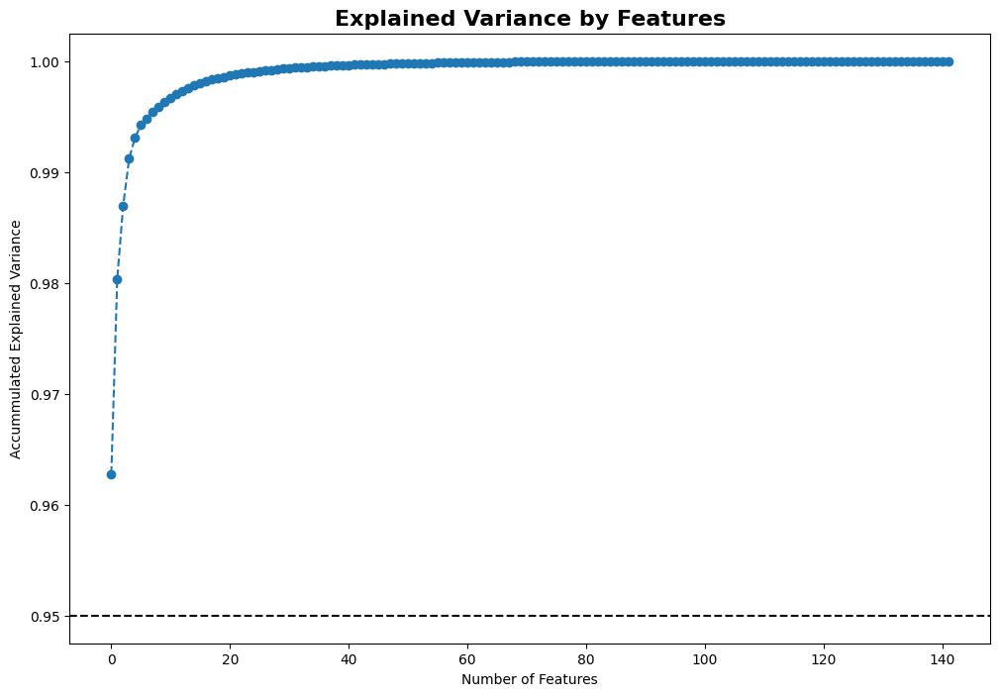

In [47]:
#we have choosen RobustScaler because we have non-normally distributed features with outliers
scaler=RobustScaler()
x_train_num_scale=scaler.fit_transform(X_train_num_clean)

pca=PCA(n_components=len(list(X_train_num_clean.columns)))
X_PCA=pca.fit_transform(x_train_num_scale)

plt.figure(figsize=(12,8))
plt.plot(np.cumsum(pca.explained_variance_ratio_),marker='o',linestyle='--')
plt.axhline(0.95,ls='--',c='black')
plt.ylabel('Accummulated Explained Variance')
plt.xlabel('Number of Features')
plt.title('Explained Variance by Features',size=16,fontweight='bold')

Davies-Bouldin Index: 0.2860
PCA structure is good (Use PCA).


Text(0.5, 1.0, 'PCA (2 components) - Separation by League-Joined')

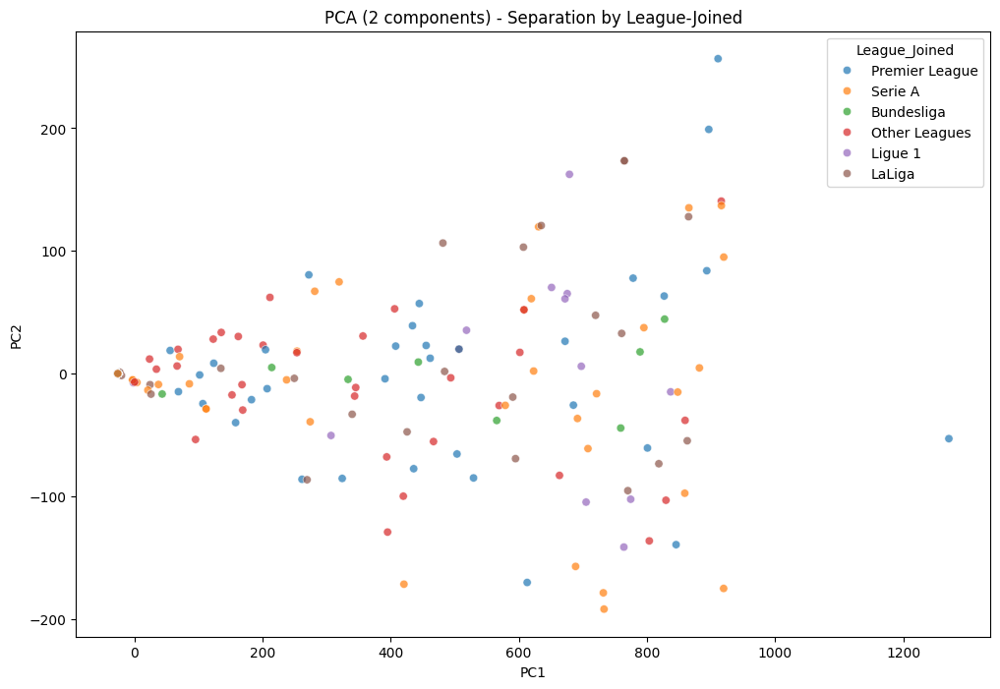

In [48]:
pca=PCA(n_components=2)
X_PCA=pca.fit_transform(x_train_num_scale)

df_pca = pd.DataFrame(X_PCA, columns=["PC1", "PC2"])
df_pca["League_Joined"] = y_train.values  # add target labels

check_pca_separation(X_PCA)

plt.figure(figsize=(12,8))
sns.scatterplot(data=df_pca, x="PC1", y="PC2", hue="League_Joined", palette="tab10", alpha=0.7)
plt.title("PCA (2 components) - Separation by League-Joined")

c:\Users\gandj\OneDrive\Desktop\Case_Study\Football\Transfers\Transfer_Target_Model\venv\Lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


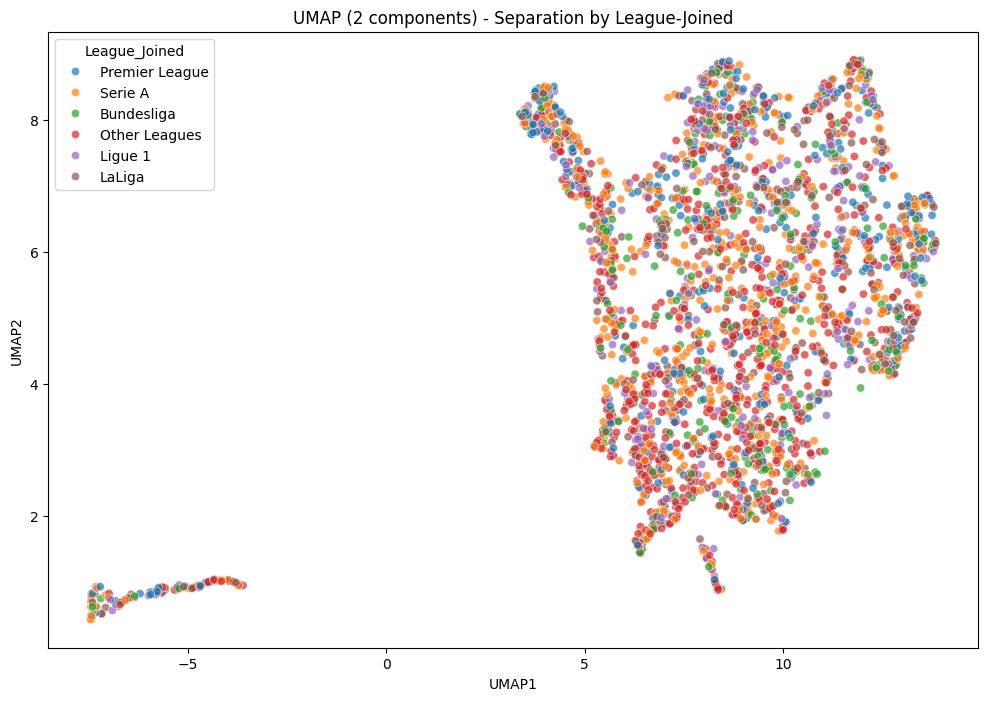

In [ ]:
# Fit + transform
umap_model = umap.UMAP(n_components=2, random_state=101)
X_UMAP = umap_model.fit_transform(x_train_num_scale)

# Build DataFrame with two distinct columns
df_umap = pd.DataFrame(X_UMAP, columns=["UMAP1", "UMAP2"])
df_umap["League_Joined"] = y_train.values  # add target labels

# Plot
plt.figure(figsize=(12,8))
sns.scatterplot(data=df_umap, x="UMAP1", y="UMAP2", hue="League_Joined", palette="tab10", alpha=0.7)
plt.title("UMAP (2 components) - Separation by League-Joined")

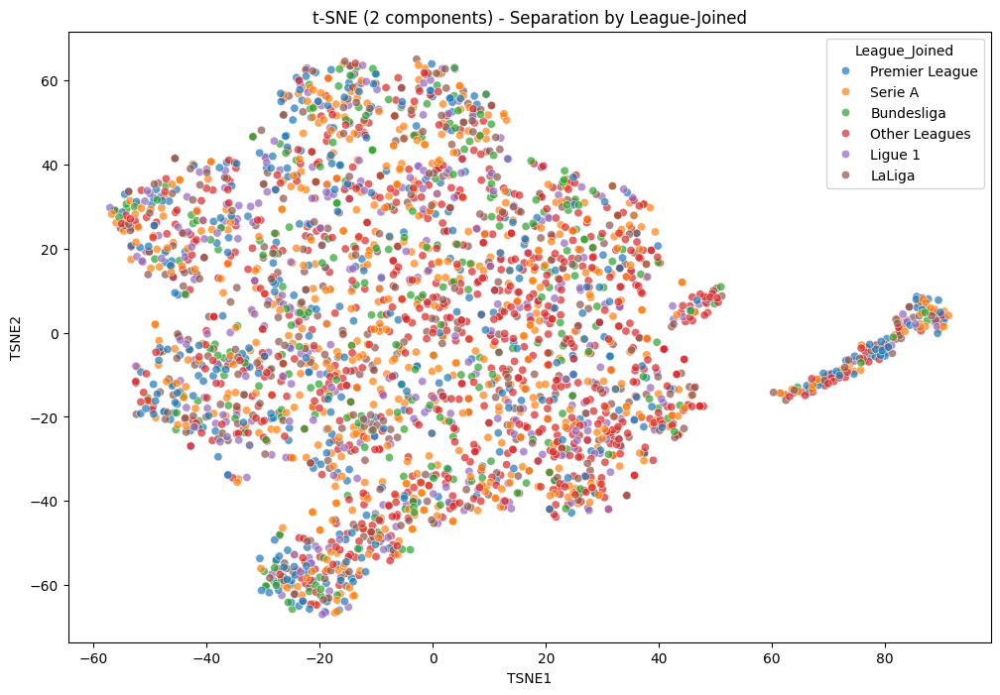

In [ ]:
# Fit + transform
tsne = TSNE(n_components=2, random_state=42, perplexity=30, learning_rate=200)
X_TSNE = tsne.fit_transform(x_train_num_scale)

# Build DataFrame
df_tsne = pd.DataFrame(X_TSNE, columns=["TSNE1", "TSNE2"])
df_tsne["League_Joined"] = y_train.values

# Plot
plt.figure(figsize=(12,8))
sns.scatterplot(data=df_tsne, x="TSNE1", y="TSNE2", hue="League_Joined", palette="tab10", alpha=0.7)
plt.title("t-SNE (2 components) - Separation by League-Joined")

Based on the tests, PCA is the appropriate method, but when we look at the PCA-scatterplot and compare it with the UMAP/t-SNE-scatterplots, we can see that the different leagues overlap, but the non-linear methods seem to better catch the data structure better. So we do not have a clear seperation, this speaks for tree-based model. The tree-based models are better in picking up patterns, even though y classes are strongly overlapping.

# Summary

- Our data does not have any null values.
- The numeric features;
    - Do not follow a normal distribution
    - Features contain outliers
    - Features correlated strongly with each other (dealing with multicollinarity)
- The categorical features;
    - Checking for imbalance, we are dealing with a mild imbalance; macro F1 score, recall and precssion will be used to evaluate teh models
    - Performing Feature Engineering (binning and encoding)
    - All X features do not follow a linear trend based on the y classes
- Based on the ANOVA test
    - The majority of the x features differ between the different y classes
    - The categorical features have different distributions based on the different y classes
- Cluster Analysis
    - Methods like UMAP and t-SNE capture the data the best, which indicates non-linear pattern

These aspects indicate, that we should use tree-based models, these models will be able to deal with the data's characteristic.

Following models will be used
- Light GBM
- CatBoost
- XGBoost

These models will be trained via pipeline. As already stated, we will use binning and mean encoding for League_Left, Club_Left and Nations. For Age and Position we will use One-Hot encdoing. We will also use feature selection, because the data does not have a normal distribution, non-linear, hast outliers we will use RandomForest Classifier.